# Import libraries

In [1]:
import os
import time
import string
import pandas as pd, numpy as np
from matplotlib import pyplot as plt
from scipy.stats import randint
import seaborn as sns # used for plot interactive graph.
import matplotlib.pyplot as plt
import seaborn as sns
from io import StringIO
import pickle

In [2]:
import sklearn
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import chi2
from IPython.display import display
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn import svm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, recall_score
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


In [3]:
from PIL import Image
import pytesseract
from torchvision import transforms
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /home/biline/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# Import data

In [4]:
df = pd.read_csv('data_augmented_preprocessed.csv')

In [5]:
df.head()

,label,text,id,invoice,receipt,resume
0,resume,CONTACT Adresse : 22 rue la porte jaune 92210 ...,0,0,0,1
1,resume,Howard Stern Hawes eres 6 years Depiral Produc...,0,0,0,1
2,resume,ASMAA AGNAOU CONTROLEUR GESTION asmaa.agnaouu@...,0,0,0,1
3,resume,TAHIROU DIALLO Responsable Communication Digit...,0,0,0,1
4,receipt,"Thank You, Flease cose again. « Goods 801d Not...",0,0,1,0


In [6]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
labels = df['label']
df['label'] = label_encoder.fit_transform(labels)

In [7]:
label2idx = {'id': 0, 'invoice': 1, 'receipt': 2, 'resume': 3}

## Change label

In [8]:
# Create a new column 'category_id' with encoded categories 
df['label_id'] = df['label'].factorize()[0]
label_id_df = df[['label', 'label_id']].drop_duplicates()

# Dictionaries for future use
label_to_id = dict(label_id_df.values)
id_to_label = dict(label_id_df[['label_id', 'label']].values)
# New dataframe
df.head()

,label,text,id,invoice,receipt,resume,label_id
0,3,CONTACT Adresse : 22 rue la porte jaune 92210 ...,0,0,0,1,0
1,3,Howard Stern Hawes eres 6 years Depiral Produc...,0,0,0,1,0
2,3,ASMAA AGNAOU CONTROLEUR GESTION asmaa.agnaouu@...,0,0,0,1,0
3,3,TAHIROU DIALLO Responsable Communication Digit...,0,0,0,1,0
4,2,"Thank You, Flease cose again. « Goods 801d Not...",0,0,1,0,1


# Classification using word2vec

## word2vec

In [9]:
import pandas as pd
from gensim.models import Word2Vec
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [10]:
# Split the data into features and target
X = df['text']
y = df['label']
# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [11]:
# Tokenize the sentences into words
tokenized_sentences = [text.split() for text in X_train]
# Train the Word2Vec model
word2vec_model = Word2Vec(tokenized_sentences, vector_size=25, window=15, min_count=1)
print(word2vec_model)
# Function to transform sentences into word vectors
def sentence_to_vectors(sentence):
    vectors = [word2vec_model.wv[word] for word in sentence.split() if word in word2vec_model.wv]
    print(vectors)
    return sum(vectors) / len(vectors) if vectors else []

# Transform the sentences into word vectors
X_train_encoded = [sentence_to_vectors(sentence) for sentence in X_train]
X_test_encoded = [sentence_to_vectors(sentence) for sentence in X_test]


Word2Vec<vocab=47674, vector_size=15, alpha=0.025>
[array([-1.0363777 ,  0.4386817 ,  1.0061659 , -1.0245233 , -0.16204622,
        0.24939232, -0.21118852, -0.24407597,  1.1511866 ,  0.13876519,
        0.305838  ,  0.6752812 ,  1.028072  , -0.77045697, -0.33276188],
      dtype=float32), array([-1.1152596 ,  0.38686875,  1.5398318 , -1.1960865 ,  0.08085954,
        0.28613344, -0.00252708, -0.02698109,  1.0690547 ,  0.38047776,
        0.9901807 ,  0.90319693,  1.2137448 , -1.0188273 , -0.52632874],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859  , -6.217227  ,  0.9093621 ,
        1.2610061 ,  0.56275207,  1.0120267 ,  5.046872  ,  1.6816351 ,
        4.528705  ,  3.7285607 ,  5.4634004 , -6.00682   , -2.16213   ],
      dtype=float32), array([-7.3278213 ,  2.1903465 ,  8.558504  , -7.7376046 ,  1.1290809 ,
        1.4047401 ,  0.95429385,  1.4852562 ,  5.96045   ,  2.256065  ,
        6.0495234 ,  4.796757  ,  6.740995  , -7.560185  , -2.685236  ],
      dtype=fl

[array([-7.4294338e+00, -7.1035973e-03,  1.8069159e+01, -1.1077394e+01,
        6.4819117e+00,  1.8989015e+00,  7.6753411e+00,  6.0280223e+00,
        7.1865988e-01,  7.7582283e+00,  2.0307602e+01,  7.5901432e+00,
        9.0045395e+00, -1.1620881e+01, -5.0172820e+00], dtype=float32), array([ 0.00922187, -0.05939819,  0.0819224 , -0.00845498,  0.06487352,
        0.06835774, -0.06273372, -0.02203109,  0.01443698,  0.02031378,
        0.0285469 ,  0.05507455, -0.00543249, -0.03416704,  0.04676346],
      dtype=float32), array([-0.3862726 , -0.065983  ,  0.9577805 , -0.64217746,  0.36877608,
        0.13395213,  0.46802175,  0.4290568 ,  0.01120677,  0.34359428,
        1.1041267 ,  0.42653647,  0.4101128 , -0.57498175, -0.18054591],
      dtype=float32), array([-0.14209433,  0.10477131,  0.11431872, -0.04207939,  0.03322135,
        0.03418257, -0.03304236,  0.04430866,  0.05491051,  0.03600879,
       -0.0001481 ,  0.01688557,  0.0706264 , -0.01579184, -0.02487702],
      dtype=float32

[array([ 0.02585201, -0.06074641,  0.02462621,  0.00265623,  0.03007626,
        0.00158934,  0.01051108,  0.06313998, -0.05147981,  0.06869439,
        0.06052896,  0.07128854,  0.021553  ,  0.00984193, -0.0277366 ],
      dtype=float32), array([-0.01977855, -0.03641608,  0.24140379, -0.03350495,  0.10158198,
        0.07360257,  0.12131342,  0.06272485, -0.02345405,  0.0393404 ,
        0.299261  ,  0.06351002,  0.04935708, -0.13973449, -0.05102303],
      dtype=float32), array([-7.2174745,  1.6735122, 12.488027 , -9.628648 ,  3.7062857,
        2.9931078,  5.7242575,  2.8394046,  3.0875063,  5.3822823,
       13.470995 ,  6.7116156,  8.6110325, -9.584799 , -4.2374997],
      dtype=float32), array([ 0.01405222,  0.05230774,  0.05557453,  0.00534526, -0.02121698,
       -0.02343552,  0.05315307, -0.02823775, -0.04910555,  0.05660961,
        0.10975864,  0.07647607, -0.01899545, -0.01521468, -0.06780325],
      dtype=float32), array([-0.93466395, -0.4346681 ,  2.7446399 , -1.6354033 ,

[array([-0.0718009 ,  0.04014333,  0.13214707, -0.03264599,  0.10957291,
        0.02333216,  0.10806751,  0.03066231, -0.00287589,  0.03430433,
        0.11548595,  0.04214827,  0.11110754, -0.06355396, -0.01975029],
      dtype=float32), array([ 0.03688818,  0.0496242 ,  0.03378172,  0.00106254, -0.01139834,
       -0.02668783,  0.09397978, -0.0325247 ,  0.00110726, -0.01749178,
        0.03626319,  0.05909943, -0.03145972, -0.08061934, -0.02211327],
      dtype=float32), array([ 0.0587941 , -0.14744906,  0.44103777, -0.19992258,  0.16018209,
       -0.03133164,  0.2890892 ,  0.14384429, -0.33544078,  0.29129884,
        0.6413591 ,  0.06686062,  0.08487602, -0.03545089, -0.19511506],
      dtype=float32), array([ 0.02576898, -0.6199711 ,  2.8710017 , -1.1678752 ,  1.3151882 ,
        0.14248651,  1.8075267 ,  1.2203414 , -1.1653017 ,  1.617408  ,
        3.8883975 ,  0.77263635,  0.68722373, -1.0435762 , -0.6849505 ],
      dtype=float32), array([-0.05414035, -0.00978561,  0.0281808

[array([-0.0751124 , -0.08680796,  0.2664803 , -0.11068835,  0.10157812,
       -0.01646646,  0.07388087,  0.13336574, -0.09079337,  0.12469546,
        0.28903395,  0.04660873,  0.13416848, -0.15200317, -0.09469513],
      dtype=float32), array([-1.28252441e-02, -6.08243085e-02,  1.30694017e-01, -1.07788824e-01,
       -1.24338055e-02,  6.04259409e-03,  1.15228847e-01,  6.73444048e-02,
       -1.27207516e-02,  1.15328968e-01,  1.44653946e-01,  5.41387126e-05,
        9.98049527e-02, -7.47278556e-02, -8.00485983e-02], dtype=float32), array([ 0.0393732 , -0.06954116,  0.59055823, -0.15645885,  0.30639696,
        0.01642011,  0.40852216,  0.3010089 , -0.20988093,  0.3733593 ,
        0.9140608 ,  0.18853435,  0.08330718, -0.18661252, -0.15737204],
      dtype=float32), array([ 0.01233178,  0.03011338,  0.16400185, -0.14230148, -0.0074344 ,
       -0.00779705,  0.03915246,  0.06635634,  0.05636883,  0.03913289,
        0.18570893,  0.0872955 ,  0.04174418, -0.13982013, -0.06496898],
    

[array([-1.0363777 ,  0.4386817 ,  1.0061659 , -1.0245233 , -0.16204622,
        0.24939232, -0.21118852, -0.24407597,  1.1511866 ,  0.13876519,
        0.305838  ,  0.6752812 ,  1.028072  , -0.77045697, -0.33276188],
      dtype=float32), array([-1.1152596 ,  0.38686875,  1.5398318 , -1.1960865 ,  0.08085954,
        0.28613344, -0.00252708, -0.02698109,  1.0690547 ,  0.38047776,
        0.9901807 ,  0.90319693,  1.2137448 , -1.0188273 , -0.52632874],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859  , -6.217227  ,  0.9093621 ,
        1.2610061 ,  0.56275207,  1.0120267 ,  5.046872  ,  1.6816351 ,
        4.528705  ,  3.7285607 ,  5.4634004 , -6.00682   , -2.16213   ],
      dtype=float32), array([-0.5735099 ,  0.09766795,  0.9130101 , -0.6541712 ,  0.1619149 ,
        0.16403842,  0.17345704,  0.25135756,  0.3218729 ,  0.2515281 ,
        0.82984513,  0.41237095,  0.5083297 , -0.6639797 , -0.32268998],
      dtype=float32), array([-1.962806  ,  0.2987945 ,  2.766541 

[array([-0.52926654, -0.5401767 ,  4.2408705 , -2.0190463 ,  2.0352914 ,
        0.31475058,  2.598531  ,  1.7086661 , -1.0400317 ,  2.2228367 ,
        5.596728  ,  1.5188965 ,  1.3874512 , -1.9643915 , -1.1336141 ],
      dtype=float32), array([ 0.16362734, -0.45281905,  2.678185  , -1.0025723 ,  1.1862122 ,
        0.11271897,  1.8068329 ,  1.0010607 , -1.1516428 ,  1.6019813 ,
        3.7398634 ,  0.67185855,  0.6003769 , -0.9257597 , -0.7893219 ],
      dtype=float32), array([-0.00450593, -0.06677731,  0.19717541, -0.11295171,  0.08634192,
        0.0328853 ,  0.12546803,  0.1657327 , -0.11357948,  0.12459273,
        0.3339114 ,  0.09123132,  0.06620391, -0.05593697, -0.12622078],
      dtype=float32), array([-2.713835  ,  0.2279242 ,  6.067214  , -4.0989923 ,  2.1029482 ,
        0.82306916,  2.5865476 ,  2.019698  ,  0.5856579 ,  2.5944533 ,
        6.9471326 ,  2.7920818 ,  3.391139  , -4.061226  , -1.722552  ],
      dtype=float32), array([ 1.600155  , -1.5676861 ,  4.1261277

[array([-0.06069466, -0.06663905,  0.12870015, -0.01499596,  0.07340819,
       -0.02673299,  0.09829342,  0.10964926, -0.0117719 ,  0.0280718 ,
        0.16115218, -0.00498316,  0.09591613, -0.02609983, -0.02248584],
      dtype=float32), array([-0.00950636,  0.00081207,  0.3871642 , -0.19167255,  0.19154303,
        0.03370253,  0.24446857,  0.17827041, -0.09612893,  0.16909012,
        0.4450993 ,  0.12734017,  0.10398664, -0.13700749, -0.08998403],
      dtype=float32), array([-0.02824879, -0.06948882,  0.31430906, -0.14491056,  0.22427444,
       -0.02673459,  0.23555467,  0.14686489, -0.14627482,  0.24921447,
        0.52466094,  0.08785306,  0.1732873 , -0.23195596, -0.1325504 ],
      dtype=float32), array([-0.00189812, -0.05375565,  0.1869893 , -0.104482  ,  0.02669991,
        0.02560061,  0.04146234,  0.03722118,  0.0276586 ,  0.08861072,
        0.14545816,  0.01062623, -0.01371618, -0.03072917,  0.01312849],
      dtype=float32), array([-0.22094414, -0.14927666,  1.0796171

[array([ 0.03865113, -0.02138168, -0.01038301, -0.03479706,  0.02162628,
        0.03071786,  0.08078063,  0.03534912, -0.01523111, -0.02118574,
        0.03234513,  0.07536642,  0.02367178, -0.07796099, -0.03551926],
      dtype=float32), array([-0.05815075, -0.02012265,  0.02056395,  0.04739073,  0.01070857,
       -0.03438831,  0.07672503,  0.01456259, -0.03366842,  0.04405677,
        0.09922285,  0.07416049,  0.06074895, -0.01181556, -0.02095086],
      dtype=float32), array([ 0.01706994, -0.07749881,  0.13969438, -0.07114761,  0.14656983,
        0.01280039,  0.10687533,  0.12034068, -0.04032341,  0.06512456,
        0.31208587,  0.10539319,  0.01666064, -0.04421674, -0.01423445],
      dtype=float32), array([ 0.08250263, -0.32318476,  1.3625408 , -0.45636013,  0.5228726 ,
        0.00259154,  0.9075804 ,  0.4595508 , -0.60271084,  0.7206914 ,
        1.8884449 ,  0.3127722 ,  0.3457776 , -0.38939276, -0.4033544 ],
      dtype=float32), array([ 0.05217351,  0.03182005,  0.0881892

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-0.15967564,  0.01750176,  0.35390434, -0.1779695 ,  0.08987679,
        0.07553238,  0.16869873,  0.1545328 ,  0.04165412,  0.18110971,
        0.44682953,  0.2117554 ,  0.20384265, -0.23457019, -0.08059806],
      dtype=float32), array([-0.02401715,  0.0554951 ,  0.19926968, -0.09013954, -0.01176443,
        0.09319095,  0.02290139,  0.00336554,  0.08474153,  0.13225327,
        0.17835899,  0.03803448,  0.05371583, -0.17439489, -0.09927054],
      dtype=float32), array([-0.1128836 ,  0.03344835,  0.5402397 , -0.35224915,  0.1343877 ,
        0.06716593,  0.25896892,  0.18198915, -0.0015726 ,  0.19257882,
        0.5332713 ,  0.2479821 ,  0.27346444, -0.2759676 , -0.13483869],
      dtype=float32), array([-0.88819695,  0.06352162,  2.0564394 , -1.2730678 ,  0.75244534,
        0.30176228,  0.8203794 ,  0.716818  ,  0.26593876,  0.9079646 ,
        2.243645  ,  0.8477668 ,  0.98558754, -1.3121874 , -0.58888423],
      dtype=float32), array([-0.9727648 , -0.0051498 ,  2.300838 

[array([ 0.00620891, -0.04525009,  0.0190952 ,  0.00207437, -0.03767767,
       -0.03598369, -0.01373413, -0.00976379,  0.10610275, -0.04693073,
       -0.06932197, -0.02158407,  0.01427673, -0.09178449,  0.0367585 ],
      dtype=float32), array([-5.1001863,  1.4198363,  6.34986  , -5.722524 ,  1.7318981,
        1.3345729,  1.786817 ,  1.7488708,  3.0509315,  2.1923702,
        6.0675464,  3.9353273,  5.125077 , -5.873733 , -1.8256077],
      dtype=float32), array([-0.01191654,  0.00433391, -0.04939037, -0.05833095, -0.04945786,
       -0.01266019, -0.00310718,  0.02770071,  0.06535962, -0.06187442,
       -0.06997734,  0.02262789,  0.04562218, -0.0192369 ,  0.01653358],
      dtype=float32), array([-0.9384781 ,  0.23372643,  1.4496384 , -1.110212  ,  0.48117948,
        0.15549482,  0.42122054,  0.48542896,  0.5836113 ,  0.48982516,
        1.2522025 ,  0.6981467 ,  0.86613584, -1.177301  , -0.3415135 ],
      dtype=float32), array([-0.6138865 ,  0.04292051,  0.8641701 , -0.7461536 ,

[array([-0.0358032 ,  0.06797341,  0.03452701, -0.08907543,  0.04461749,
        0.01971978,  0.02945821,  0.03875392,  0.05479037, -0.01207941,
       -0.01816945,  0.05886593,  0.06675719, -0.07167647,  0.01104841],
      dtype=float32), array([-1.094142  ,  0.1859568 ,  1.5740573 , -1.1776199 ,  0.3595185 ,
        0.1352364 ,  0.38758764,  0.35090056,  0.6656198 ,  0.48419037,
        1.2379873 ,  0.70262444,  0.88045645, -1.1582483 , -0.43047038],
      dtype=float32), array([-0.03259995,  0.09867408,  0.10766841, -0.08661891,  0.02028212,
       -0.03761952,  0.02947799, -0.07919468,  0.05706613,  0.01621475,
        0.02683849,  0.05955494, -0.00196328, -0.05147961, -0.01282626],
      dtype=float32), array([-1.4338095 ,  0.27716607,  2.3793926 , -1.8702109 ,  0.56673205,
        0.31613296,  0.6514156 ,  0.64445484,  0.919775  ,  0.805945  ,
        2.0520067 ,  1.1998593 ,  1.3961992 , -1.7318339 , -0.72951204],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859 

[array([-0.27462712, -0.06402808,  1.036855  , -0.5404885 ,  0.3684543 ,
        0.09059668,  0.47345513,  0.33775136, -0.10970025,  0.39430088,
        1.2031481 ,  0.4062952 ,  0.47394177, -0.52291876, -0.28007185],
      dtype=float32), array([-0.6643834 , -0.32045317,  3.7296546 , -1.9447172 ,  1.8525817 ,
        0.39605686,  2.1623614 ,  1.4863116 , -0.69471216,  1.7931964 ,
        4.76278   ,  1.4792393 ,  1.3007885 , -1.9288157 , -0.91961396],
      dtype=float32), array([-0.31522524, -0.13737091,  1.5120908 , -0.8257095 ,  0.749512  ,
        0.18369135,  0.9203325 ,  0.5807842 , -0.23788956,  0.7316546 ,
        1.9520359 ,  0.5337451 ,  0.5867401 , -0.8222511 , -0.43424577],
      dtype=float32), array([-0.6359379 , -0.12326231,  1.5195125 , -1.0132105 ,  0.85526454,
        0.2533992 ,  0.69538134,  0.7270991 ,  0.12666419,  0.632668  ,
        1.9176366 ,  0.7251174 ,  0.70524204, -1.1463423 , -0.19446698],
      dtype=float32), array([-0.26923797, -0.10507865,  0.7970868

[array([-0.2591775 , -0.69030625,  3.7194357 , -1.72563   ,  1.7312361 ,
        0.34472844,  2.347246  ,  1.5568278 , -1.143169  ,  2.0157723 ,
        5.060479  ,  1.2221661 ,  1.1141195 , -1.6138176 , -0.9195795 ],
      dtype=float32), array([-0.48133302,  0.09947229,  1.0601811 , -0.7783059 ,  0.30180234,
        0.11158638,  0.36043668,  0.34481317,  0.20526877,  0.5072819 ,
        1.1164716 ,  0.45866737,  0.6303655 , -0.8074936 , -0.37228623],
      dtype=float32), array([-1.1476552 ,  0.15090363,  2.1101403 , -1.4672543 ,  0.7113866 ,
        0.47888047,  0.74012786,  0.69256777,  0.65134263,  0.7468809 ,
        2.0901673 ,  1.1137418 ,  1.2375755 , -1.5627047 , -0.4855702 ],
      dtype=float32), array([-0.01404928, -0.0075312 ,  0.02276108, -0.05283776,  0.03284537,
        0.08966288,  0.07233521,  0.03411303,  0.01677954, -0.03246605,
        0.20235622,  0.06033766,  0.01177461, -0.1516999 ,  0.05834074],
      dtype=float32), array([-0.5977602 ,  0.17845613,  0.834864 

[array([-0.08724534,  0.02914464,  0.00610225,  0.02284071, -0.02069472,
        0.05471281, -0.01875739,  0.06188367,  0.02505922, -0.0090141 ,
        0.06870174,  0.0148499 ,  0.0909392 ,  0.03603663, -0.02041023],
      dtype=float32), array([-0.08823581, -0.04575103,  0.10625699, -0.18988615,  0.17653888,
        0.00925295,  0.05620868,  0.13264155, -0.02895949,  0.05585472,
        0.2674767 ,  0.04296101,  0.08395808, -0.10340764,  0.05812557],
      dtype=float32), array([-0.16598907, -0.01491649,  0.45323122, -0.19387642,  0.13691954,
        0.09455361,  0.1952347 ,  0.18951036, -0.06848372,  0.17388576,
        0.5921607 ,  0.14877178,  0.13142432, -0.23975961, -0.18773127],
      dtype=float32), array([ 0.02599481,  0.03846288,  0.12828457, -0.04524625,  0.0007852 ,
       -0.01951269,  0.04874204,  0.04301487,  0.0139397 , -0.03115119,
        0.07834008,  0.0576484 , -0.0122946 , -0.04771515, -0.01542423],
      dtype=float32), array([-0.07976949, -0.01345409,  0.3272209

[array([-0.16422865, -0.08547325,  0.3513267 , -0.21992326,  0.15460701,
        0.04728359,  0.19664626,  0.16059624, -0.01392038,  0.22321413,
        0.56023425,  0.20332587,  0.17886238, -0.20779844, -0.0701862 ],
      dtype=float32), array([-0.09575443, -0.01517631,  0.49865553, -0.26851186,  0.16286367,
        0.01861479,  0.25456974,  0.1641913 ,  0.01471564,  0.27347392,
        0.61545795,  0.20321365,  0.24208716, -0.24052915, -0.05572419],
      dtype=float32), array([-4.09554   ,  0.94523555,  6.4409184 , -4.9398384 ,  2.2035851 ,
        0.9842117 ,  2.2597878 ,  1.8958293 ,  1.9045231 ,  2.5254805 ,
        6.482641  ,  3.4301863 ,  4.34954   , -5.328908  , -1.825461  ],
      dtype=float32), array([-1.0036645 , -0.31971908,  4.0879636 , -2.228631  ,  2.0443597 ,
        0.44943216,  2.3863208 ,  1.6209654 , -0.49035707,  1.9809875 ,
        5.145942  ,  1.6626438 ,  1.6166962 , -2.486246  , -1.0038826 ],
      dtype=float32), array([-6.17939346e-02,  6.24174427e-05,  3

[array([-0.4483756 ,  0.05330675,  0.6414051 , -0.4448478 ,  0.33077532,
       -0.08457072,  0.22348277,  0.3779639 ,  0.15389813,  0.21479735,
        0.45510682,  0.27684343,  0.3045121 , -0.61607677, -0.09497618],
      dtype=float32), array([-0.07417686,  0.03947103,  0.02394615,  0.01584223, -0.04937772,
        0.01309149,  0.04715087, -0.00701253,  0.04775406,  0.00897895,
       -0.02847948, -0.02699389,  0.04555407, -0.06091511, -0.00056025],
      dtype=float32), array([-0.971323  ,  0.2252374 ,  1.148026  , -1.0530765 ,  0.2698127 ,
        0.19561248,  0.1374176 ,  0.23938036,  0.6673557 ,  0.2836783 ,
        0.9256677 ,  0.6589123 ,  0.8503738 , -1.0405511 , -0.29562706],
      dtype=float32), array([-0.33732828,  0.09486549,  0.49320224, -0.37019566,  0.11505601,
        0.04846315,  0.13017134,  0.1721062 ,  0.1883017 ,  0.15927546,
        0.50114655,  0.3021788 ,  0.30735418, -0.4513675 , -0.22747949],
      dtype=float32), array([-7.3278213 ,  2.1903465 ,  8.558504 

[array([-0.00989871, -0.03693288,  0.05726099,  0.00928724,  0.072428  ,
        0.01639374, -0.01819199, -0.02952684, -0.04237157,  0.02804082,
        0.09751802,  0.0253626 ,  0.05668287, -0.03882417, -0.02600466],
      dtype=float32), array([-0.07820537, -0.06141305,  0.25662473, -0.15180266,  0.19242513,
       -0.01284272,  0.10693236,  0.14103755, -0.07594905,  0.08575764,
        0.3472023 ,  0.1019737 ,  0.04499962, -0.15664461, -0.01945548],
      dtype=float32), array([-0.09016088, -0.05534058,  0.3269537 , -0.21528345,  0.2555071 ,
       -0.00764474,  0.13047755,  0.16500542,  0.03850945,  0.18701822,
        0.42898196,  0.14205806,  0.14842512, -0.24215004, -0.03548643],
      dtype=float32), array([-0.00529929, -0.06290237,  0.15756999, -0.14338295,  0.05600123,
        0.04895817,  0.11482099,  0.08103615,  0.00765803,  0.08394915,
        0.27770093,  0.09224642,  0.06240997, -0.15670466, -0.09296821],
      dtype=float32), array([-0.19482468, -0.04587274,  0.7787589

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-0.09238108, -0.03723834,  0.21687424, -0.0372442 ,  0.12314676,
        0.07163196,  0.14054012,  0.01714861,  0.00664428,  0.04339851,
        0.24965093,  0.08873417,  0.03622784, -0.1267304 , -0.0410275 ],
      dtype=float32), array([ 0.00108624,  0.00839179,  0.31239563, -0.17811364,  0.08962239,
        0.09578765,  0.29100624,  0.16540578,  0.00741813,  0.19528933,
        0.41377896,  0.12647742,  0.16723979, -0.1283262 , -0.11343835],
      dtype=float32), array([ -5.291092  ,   1.0263659 ,  23.2004    , -11.502921  ,
         2.7255127 ,   0.57871795,  10.126885  ,   4.444127  ,
        -3.3871405 ,  11.419798  ,  23.59993   ,   6.0260973 ,
        10.776019  ,  -8.34029   , -10.037728  ], dtype=float32), array([-0.08613355, -0.18099587,  0.9624901 , -0.4386543 ,  0.39964986,
       -0.03054164,  0.60397106,  0.38810974, -0.31761524,  0.57158524,
        1.1778198 ,  0.26984346,  0.33954018, -0.34842154, -0.27370754],
      dtype=float32), array([ -5.291092  ,   1.02

[array([-0.6090337 ,  0.16565743,  0.99946934, -0.75195843,  0.33662185,
        0.15692438,  0.3453276 ,  0.3058853 ,  0.37778708,  0.3274278 ,
        0.96783036,  0.5337197 ,  0.62357736, -0.68007874, -0.23639572],
      dtype=float32), array([-0.50822294,  0.07443742,  0.5647507 , -0.5315934 ,  0.1530263 ,
        0.12206172,  0.14160055,  0.15730874,  0.332832  ,  0.19072582,
        0.5147787 ,  0.28794584,  0.47986233, -0.55113834, -0.2161472 ],
      dtype=float32), array([-1.0765486 ,  0.27474692,  1.5882665 , -1.2937504 ,  0.31719372,
        0.23392716,  0.36064354,  0.34460366,  0.8895266 ,  0.45551646,
        1.3103452 ,  0.8657752 ,  1.035991  , -1.2718302 , -0.45386276],
      dtype=float32), array([-1.4338095 ,  0.27716607,  2.3793926 , -1.8702109 ,  0.56673205,
        0.31613296,  0.6514156 ,  0.64445484,  0.919775  ,  0.805945  ,
        2.0520067 ,  1.1998593 ,  1.3961992 , -1.7318339 , -0.72951204],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859 

[array([-0.08924383, -0.03657139,  0.08362313, -0.013076  ,  0.05830131,
        0.08243149,  0.01620727,  0.10653102,  0.07580734,  0.03776515,
        0.17231132,  0.06347594,  0.06025123, -0.05395964, -0.03336263],
      dtype=float32), array([-1.0034526e-01,  3.1382107e-05,  1.6693051e-01, -8.1693262e-02,
        1.3940825e-01,  7.8223720e-02,  1.4799422e-01,  1.1114244e-01,
       -5.6446586e-02,  1.5095694e-01,  3.3883435e-01,  1.4482097e-01,
        7.1935751e-02, -2.1209772e-01, -8.8623064e-03], dtype=float32), array([-1.3780414e-02, -4.8052893e+00,  1.4691497e+01, -6.4442730e+00,
        1.0243313e+01,  1.4899161e+00,  1.0116406e+01,  1.0085719e+01,
       -7.5042906e+00,  8.5504246e+00,  2.5340303e+01,  4.6429424e+00,
        2.7595088e+00, -7.6200552e+00, -1.8961756e+00], dtype=float32), array([-1.6390427 , -0.45677203,  3.006822  , -2.3379092 ,  2.0551617 ,
        0.52278364,  1.4348766 ,  2.2881713 ,  0.1995363 ,  1.10823   ,
        4.6122985 ,  1.837069  ,  1.5638436 , 

[array([-0.0297437 , -0.0295484 ,  0.2725798 , -0.08287396,  0.09290494,
        0.0169122 ,  0.18312924,  0.08722706, -0.12994914,  0.1369698 ,
        0.38000312,  0.06319734,  0.10366849, -0.07162348, -0.06825032],
      dtype=float32), array([ 0.06017016, -0.00880275,  0.03198458,  0.05443621,  0.00730894,
        0.05227495,  0.01402014, -0.01189625, -0.03451473, -0.03706772,
        0.08151258,  0.01735487, -0.04507285,  0.03016118,  0.05424713],
      dtype=float32), array([ 1.925369  , -2.1153939 ,  5.854207  , -1.1115819 ,  3.128056  ,
       -0.12437037,  4.764605  ,  2.640877  , -4.499826  ,  4.0206547 ,
        9.190559  ,  0.9182398 ,  0.3237031 , -0.93163216, -1.5948281 ],
      dtype=float32), array([ 3.1557083 , -3.199458  ,  8.372144  , -1.27389   ,  4.4216866 ,
       -0.17414613,  7.010818  ,  3.7304964 , -6.759102  ,  5.751758  ,
       13.251477  ,  1.131707  ,  0.10427796, -0.97748446, -2.2263207 ],
      dtype=float32), array([ 1.7439387 , -1.4895321 ,  3.2312653

[array([ 5.4441530e-01, -8.1708580e-01,  3.1408463e+00, -8.8050437e-01,
        1.3596517e+00, -2.0493916e-03,  2.3061166e+00,  1.2013037e+00,
       -1.8355007e+00,  1.8831965e+00,  4.5391111e+00,  6.4227235e-01,
        4.9405184e-01, -7.5349945e-01, -9.6515322e-01], dtype=float32), array([-0.16693681, -0.04087115,  0.53985816, -0.29427865,  0.19396898,
        0.00712403,  0.19126603,  0.20940915, -0.00797599,  0.22985557,
        0.56255776,  0.20478356,  0.17605066, -0.27999568, -0.1970426 ],
      dtype=float32), array([-0.01802071, -0.01025572,  0.16578944, -0.12264191,  0.05085001,
        0.00345503,  0.06948899,  0.03087526,  0.03102893,  0.1069971 ,
        0.16407655,  0.07640293,  0.1044441 , -0.06370402, -0.01109489],
      dtype=float32), array([ 3.2965953 , -3.9707794 , 10.840023  , -1.8325533 ,  5.680819  ,
       -0.06211488,  8.758856  ,  4.765368  , -8.452053  ,  7.068502  ,
       17.281662  ,  1.7307695 ,  0.38085142, -1.346698  , -3.156499  ],
      dtype=float32

[array([ 0.05430372,  0.00857519,  0.08575682, -0.0866415 ,  0.06184014,
        0.06446414,  0.00347017,  0.06531959, -0.09372128,  0.00273895,
        0.12190673,  0.07764365, -0.03133455, -0.04642251, -0.06827064],
      dtype=float32), array([-4.487699 ,  1.267885 ,  5.6549563, -5.0802627,  0.8683242,
        0.5932437,  1.1578623,  1.3359952,  2.8338892,  1.6968279,
        4.538259 ,  2.9758892,  4.456208 , -4.839273 , -2.039594 ],
      dtype=float32), array([-0.01573289, -0.07270582,  0.0539506 ,  0.00589105,  0.07788613,
       -0.03991842,  0.0757582 , -0.00694309, -0.02329136,  0.0719908 ,
        0.08216386, -0.02900527,  0.0672631 ,  0.00547243,  0.00659741],
      dtype=float32), array([-0.04564498, -0.01871721,  0.17554705, -0.0825884 ,  0.08754765,
       -0.07660861,  0.06273986,  0.07532051, -0.01681598,  0.11802921,
        0.18374364,  0.08472165,  0.11555712, -0.07490826,  0.03569672],
      dtype=float32), array([-0.6128423 , -0.24531579,  2.0589876 , -1.113733  ,

[array([-12.619644 ,   3.4356468,  16.040533 , -13.815045 ,   3.4821835,
         3.20798  ,   2.8029313,   3.7270608,   9.623629 ,   4.67426  ,
        13.166321 ,   8.865535 ,  12.138817 , -13.873924 ,  -4.6698055],
      dtype=float32), array([-0.05616539, -0.04782672,  0.16044198, -0.07971055,  0.07281935,
        0.08591039,  0.04970505,  0.01743144,  0.08948673,  0.05819013,
        0.16251376,  0.07162553,  0.09272997, -0.11427169, -0.08104968],
      dtype=float32), array([ -6.3707423,  -0.9969326,  20.857319 , -11.891567 ,   7.967674 ,
         2.243213 ,  10.297805 ,   6.9222717,  -0.8349247,   9.619561 ,
        24.639727 ,   8.205388 ,   9.104475 , -11.921408 ,  -5.7140007],
      dtype=float32), array([-0.08737702, -0.0185965 ,  0.15533778, -0.15266378,  0.04764921,
        0.05708351,  0.05665867, -0.00798394,  0.12069803,  0.0855113 ,
        0.19776912,  0.09114598,  0.16301417, -0.20549576, -0.10326212],
      dtype=float32), array([-0.07479649, -0.03717366,  0.1510790

[array([-0.08775447, -0.02675355,  0.24345416, -0.04700391,  0.05708533,
       -0.03803962,  0.10095919,  0.06595657, -0.04036029,  0.12244195,
        0.2825115 ,  0.060223  ,  0.0996465 , -0.05627563, -0.006819  ],
      dtype=float32), array([-1.1812856 , -0.3038959 ,  3.540421  , -2.016768  ,  1.7508702 ,
        0.91817266,  2.0724301 ,  1.6517683 ,  0.12374685,  1.5881709 ,
        4.457916  ,  1.5150023 ,  1.5388292 , -2.1811461 , -0.9216614 ],
      dtype=float32), array([ 0.0143103 , -0.02766907,  0.07920485, -0.01100841,  0.00072805,
       -0.02366408,  0.06623794,  0.04898372,  0.00022445,  0.04431041,
        0.05622789, -0.00064378,  0.01379283,  0.0101641 , -0.07247755],
      dtype=float32), array([-0.5449846 , -0.09384894,  2.1844037 , -1.2006757 ,  0.8611556 ,
        0.15781766,  1.1443801 ,  0.7819365 , -0.12724854,  1.0081856 ,
        2.5655138 ,  0.8199425 ,  0.9406598 , -1.1304317 , -0.59764916],
      dtype=float32), array([-0.27486247, -0.03415674,  0.6928847

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-0.24601689,  0.02974183,  0.49675483, -0.3094043 ,  0.17981151,
        0.0235885 ,  0.14554432,  0.13485503,  0.09713247,  0.2618284 ,
        0.57245606,  0.15951505,  0.19365251, -0.36231682, -0.15192965],
      dtype=float32), array([-0.6011868 , -0.10552643,  1.3586285 , -0.90089136,  0.64542204,
        0.14884211,  0.52978224,  0.51580274,  0.11289427,  0.52214414,
        1.5498853 ,  0.65183157,  0.6939111 , -0.9209371 , -0.23524426],
      dtype=float32), array([-0.87751883,  0.3123671 ,  0.70300364, -0.74465734,  0.23547968,
        0.09692282, -0.13525379,  0.10398561,  0.7985962 ,  0.07451419,
        0.31634846,  0.4521868 ,  0.5977849 , -0.8292162 , -0.08666378],
      dtype=float32), array([-0.74947387,  0.23249216,  0.5325508 , -0.58858186,  0.13067245,
        0.1193402 , -0.06613724,  0.06781461,  0.6834714 ,  0.00866584,
        0.22415356,  0.30922058,  0.5751852 , -0.7460336 , -0.13619414],
      dtype=float32), array([-0.75799924,  0.19934592,  0.5698708

[array([-0.53880304,  0.32646164,  0.42479405, -0.49680024, -0.08142152,
        0.0229023 , -0.12130022, -0.08748739,  0.649052  ,  0.02842114,
       -0.05319922,  0.22738636,  0.4359305 , -0.5122048 , -0.21954273],
      dtype=float32), array([-0.67073846,  0.35419232,  0.5421455 , -0.65620375, -0.07717532,
        0.09717466, -0.13805544, -0.020603  ,  0.79302436,  0.00535652,
        0.01493939,  0.29929996,  0.6057317 , -0.57565075, -0.19238208],
      dtype=float32), array([-0.55365074,  0.3062009 ,  0.43952796, -0.5450207 , -0.11700109,
        0.1105894 , -0.23011076,  0.04415216,  0.6549224 , -0.08213795,
       -0.01726997,  0.30006358,  0.49597606, -0.45211396, -0.205804  ],
      dtype=float32), array([-0.69973636,  0.32141182,  0.64117604, -0.7231514 , -0.0915132 ,
        0.13878281, -0.15217403,  0.0038891 ,  0.6487428 ,  0.00258319,
        0.10692001,  0.32734725,  0.65075326, -0.5848911 , -0.2673599 ],
      dtype=float32), array([-0.6057118 ,  0.41531533,  0.3724202

[array([ 0.08700836,  0.04171097,  0.02804672, -0.0455697 ,  0.01801941,
       -0.01051247, -0.0252911 , -0.04024012, -0.07236713, -0.05281214,
        0.04621927, -0.0493391 ,  0.03148146, -0.01823306, -0.02273835],
      dtype=float32), array([ 0.05393216, -0.01761413,  0.06302556, -0.04466331, -0.00534683,
       -0.00923637,  0.06795628,  0.05756303, -0.0436446 ,  0.01301097,
        0.04578489,  0.01965251, -0.00556141,  0.023737  , -0.0352669 ],
      dtype=float32), array([-0.15260021, -0.41350356,  1.6859831 , -0.63439023,  0.82632947,
        0.08617967,  0.98698896,  0.8825781 , -0.6074352 ,  0.87109566,
        2.3746705 ,  0.5550842 ,  0.4561409 , -0.7504016 , -0.37673005],
      dtype=float32), array([ 0.28075376, -0.3296374 ,  1.0920434 , -0.29179752,  0.5655418 ,
        0.04332225,  0.8692123 ,  0.4078662 , -0.748952  ,  0.71767646,
        1.5538415 ,  0.14242691,  0.04102699, -0.20143957, -0.28314465],
      dtype=float32), array([ 0.36616552, -0.5652328 ,  1.5523741

[array([ 0.0347535 ,  0.03577922,  0.11923276, -0.03881845, -0.02576504,
        0.02455783,  0.01796145,  0.010692  , -0.0670153 ,  0.0219232 ,
        0.10778142, -0.01693295,  0.05410114, -0.00176074, -0.0654984 ],
      dtype=float32), array([ 0.01821227, -0.0197625 ,  0.0222542 ,  0.02063883,  0.08516592,
        0.00478021, -0.01498873,  0.05065133,  0.01597784,  0.05864489,
        0.09403675,  0.08481909, -0.02822828,  0.0038013 , -0.03827635],
      dtype=float32), array([-0.02569105, -0.17186192,  0.82366735, -0.32303208,  0.3240811 ,
       -0.00762941,  0.52795553,  0.2997104 , -0.19575867,  0.42347577,
        1.1079262 ,  0.2969152 ,  0.2919736 , -0.30813193, -0.21935122],
      dtype=float32), array([ 0.01085814, -0.12674534,  0.43665016, -0.10224993,  0.13736527,
       -0.01560577,  0.27143383,  0.18159582, -0.22702353,  0.26978555,
        0.5189554 ,  0.13063073,  0.05008412, -0.11659792, -0.1728731 ],
      dtype=float32), array([-0.02562755, -0.13849415,  1.0978241

[array([-0.87751883,  0.3123671 ,  0.70300364, -0.74465734,  0.23547968,
        0.09692282, -0.13525379,  0.10398561,  0.7985962 ,  0.07451419,
        0.31634846,  0.4521868 ,  0.5977849 , -0.8292162 , -0.08666378],
      dtype=float32), array([-0.74947387,  0.23249216,  0.5325508 , -0.58858186,  0.13067245,
        0.1193402 , -0.06613724,  0.06781461,  0.6834714 ,  0.00866584,
        0.22415356,  0.30922058,  0.5751852 , -0.7460336 , -0.13619414],
      dtype=float32), array([-0.75799924,  0.19934592,  0.5698708 , -0.6811162 ,  0.17474672,
        0.15136208, -0.02247397,  0.06809649,  0.6079666 ,  0.06510014,
        0.2766086 ,  0.32281947,  0.5798448 , -0.65069294, -0.19042805],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859  , -6.217227  ,  0.9093621 ,
        1.2610061 ,  0.56275207,  1.0120267 ,  5.046872  ,  1.6816351 ,
        4.528705  ,  3.7285607 ,  5.4634004 , -6.00682   , -2.16213   ],
      dtype=float32), array([-0.06989513, -0.00716876,  0.0593777

[array([-0.82882106,  0.04967771,  1.6920574 , -1.081229  ,  0.74587375,
        0.24933904,  0.770372  ,  0.6544225 ,  0.19066231,  0.7817908 ,
        1.9973047 ,  0.794567  ,  0.92348427, -1.2329468 , -0.3997549 ],
      dtype=float32), array([-0.1355534 , -0.06925602,  0.24175562, -0.17192432,  0.18027796,
        0.08754979,  0.05034658,  0.09408442,  0.00259759,  0.16219918,
        0.30900997,  0.17820762,  0.10127516, -0.24642923, -0.07101724],
      dtype=float32), array([-0.08879201, -0.02652603,  0.14937088, -0.10852478,  0.04822337,
        0.06656798,  0.07972248,  0.07659361,  0.01460447,  0.1317456 ,
        0.16945305,  0.1121408 ,  0.1039944 , -0.11656364,  0.02237029],
      dtype=float32), array([-0.02880049,  0.06162755,  0.09852421, -0.06543805,  0.02986484,
        0.05705931,  0.08619107, -0.01324102,  0.04103338,  0.02513028,
        0.11920336,  0.03489711, -0.02052549, -0.10821457, -0.07938024],
      dtype=float32), array([ -6.106388  ,  -1.1619945 ,  18.9821

[array([-0.02658222,  0.06362761,  0.09250315, -0.10244451,  0.04562831,
        0.07074707,  0.01836443,  0.01547726,  0.0268817 ,  0.02971414,
       -0.0095517 ,  0.03948545,  0.08268666, -0.01940616,  0.02175565],
      dtype=float32), array([-0.48133302,  0.09947229,  1.0601811 , -0.7783059 ,  0.30180234,
        0.11158638,  0.36043668,  0.34481317,  0.20526877,  0.5072819 ,
        1.1164716 ,  0.45866737,  0.6303655 , -0.8074936 , -0.37228623],
      dtype=float32), array([-0.16898267,  0.06450824,  0.10391301, -0.13659284,  0.06920197,
        0.02395514, -0.0161689 , -0.02247493,  0.09689401, -0.00939271,
        0.0288042 ,  0.11551829,  0.08050273, -0.10897192, -0.02472233],
      dtype=float32), array([-0.07819024, -0.04768717,  0.27578267, -0.18035151,  0.09103714,
       -0.03238776,  0.01161559,  0.12361834,  0.04021937,  0.12859093,
        0.20688082,  0.14728719,  0.09756982, -0.15080787, -0.11539192],
      dtype=float32), array([-0.18922737,  0.03918682,  0.1618766

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-0.06297768,  0.06682398,  0.07407042, -0.05432112,  0.05024273,
        0.06565971, -0.00723929, -0.06216038, -0.02051209,  0.06366716,
       -0.00979933,  0.00201653,  0.08304515, -0.04524038,  0.05113607],
      dtype=float32), array([-2.1094556 , -0.08850634,  4.1628923 , -2.9579892 ,  1.7426041 ,
        0.5080333 ,  1.6676799 ,  1.7858958 ,  0.6006969 ,  1.6872107 ,
        4.822896  ,  2.0626776 ,  2.1957984 , -3.2139459 , -0.8621494 ],
      dtype=float32), array([-2.510658  , -1.2750037 , 13.942622  , -6.336021  ,  6.341741  ,
       -0.26929533,  7.5755825 ,  5.623617  , -3.2151847 ,  6.7867694 ,
       15.797253  ,  4.265684  ,  4.533339  , -7.178122  , -3.5299277 ],
      dtype=float32), array([-1.0363777 ,  0.4386817 ,  1.0061659 , -1.0245233 , -0.16204622,
        0.24939232, -0.21118852, -0.24407597,  1.1511866 ,  0.13876519,
        0.305838  ,  0.6752812 ,  1.028072  , -0.77045697, -0.33276188],
      dtype=float32), array([-1.1152596 ,  0.38686875,  1.5398318

[array([-0.05433201, -0.00512145,  0.00932151, -0.03754926,  0.05692299,
       -0.05433008,  0.05895438, -0.03400886, -0.03798691, -0.0220608 ,
        0.10124589, -0.04048635,  0.07093648, -0.04971039, -0.04893278],
      dtype=float32), array([ 0.04248996,  0.01367228,  0.02227243,  0.025493  ,  0.06865323,
       -0.0612425 ,  0.00534057, -0.02062552, -0.07311778,  0.09660398,
        0.13874511,  0.03478357,  0.05419784, -0.01367139, -0.00082847],
      dtype=float32), array([ 0.4488405 , -0.60404116,  1.860303  , -0.43908283,  0.8662578 ,
        0.0187131 ,  1.4598866 ,  0.72110206, -1.2638568 ,  1.1983688 ,
        2.7395658 ,  0.23598303,  0.11799572, -0.26811236, -0.5455903 ],
      dtype=float32), array([ 0.6825983 , -0.7603133 ,  2.1651988 , -0.4553507 ,  1.0621231 ,
       -0.08532953,  1.7326069 ,  0.9640205 , -1.6900039 ,  1.4661187 ,
        3.3923998 ,  0.3691867 ,  0.13307363, -0.27059665, -0.6992956 ],
      dtype=float32), array([ 0.22639938, -0.3252604 ,  1.050246 

[array([-0.06600639, -0.04154754,  0.18149169, -0.03896059,  0.03595296,
       -0.03611634,  0.08019037,  0.00176043,  0.01365325,  0.04194856,
        0.11047937,  0.08605744,  0.06734878,  0.00634489, -0.02057417],
      dtype=float32), array([ 0.05404744,  0.05466576,  0.02603115, -0.00739775,  0.01580679,
        0.00903122,  0.09177965, -0.04051502, -0.04685762, -0.00076953,
        0.04943503,  0.03257432,  0.03456892, -0.09555287, -0.05461912],
      dtype=float32), array([ 2.9825384e-03, -7.4354357e-01,  3.3899157e+00, -1.1004776e+00,
        1.5672247e+00,  8.1129335e-02,  2.1616881e+00,  1.2551211e+00,
       -1.4711009e+00,  1.8448836e+00,  4.5581055e+00,  8.7367600e-01,
        6.1338603e-01, -1.1384927e+00, -8.2160968e-01], dtype=float32), array([ 0.4488405 , -0.60404116,  1.860303  , -0.43908283,  0.8662578 ,
        0.0187131 ,  1.4598866 ,  0.72110206, -1.2638568 ,  1.1983688 ,
        2.7395658 ,  0.23598303,  0.11799572, -0.26811236, -0.5455903 ],
      dtype=float32

[array([-0.00061207,  0.03361341,  0.00495783,  0.02927509,  0.05026897,
       -0.01630797, -0.01148644,  0.02747692, -0.070783  , -0.04159993,
        0.04060618, -0.00580385,  0.05163782,  0.04714163, -0.04531873],
      dtype=float32), array([-0.8339335 , -0.3606454 ,  2.1367052 , -1.1245979 ,  1.326648  ,
        0.24250361,  1.257772  ,  1.1903663 ,  0.04207595,  0.8747993 ,
        2.5693674 ,  0.87610364,  0.68675464, -1.4940277 , -0.28105375],
      dtype=float32), array([-3.379269  , -0.8986311 ,  8.67289   , -4.8651843 ,  4.898171  ,
        0.19814646,  4.22581   ,  4.305482  , -0.3962307 ,  3.6837008 ,
        9.830564  ,  3.7059138 ,  3.4640088 , -6.2520995 , -1.4299073 ],
      dtype=float32), array([-0.03801301, -0.02297976,  0.00582888,  0.01969355,  0.02838687,
       -0.04117253,  0.04751712,  0.00528534,  0.02616881,  0.01510385,
        0.05283807, -0.04583818, -0.01826226, -0.00194855,  0.05191958],
      dtype=float32), array([-0.18872836,  0.11652992,  0.1113373

[array([-0.0297437 , -0.0295484 ,  0.2725798 , -0.08287396,  0.09290494,
        0.0169122 ,  0.18312924,  0.08722706, -0.12994914,  0.1369698 ,
        0.38000312,  0.06319734,  0.10366849, -0.07162348, -0.06825032],
      dtype=float32), array([-0.02396317,  0.06026363,  0.04789693, -0.07059408,  0.08050626,
        0.07102461,  0.07918163,  0.04210268,  0.01069534,  0.08309916,
        0.15351114,  0.09329852, -0.00527595, -0.05196369, -0.05203398],
      dtype=float32), array([-0.05946249, -0.02284856,  0.0443442 , -0.04684525,  0.07808035,
        0.07203601,  0.07229498,  0.09996825,  0.06312378,  0.0664142 ,
        0.11955193, -0.02324924,  0.02038666, -0.05783017, -0.08922546],
      dtype=float32), array([-0.12415884, -0.03330864,  0.16408679, -0.09487125,  0.03033393,
       -0.04335465,  0.04987179,  0.06379531,  0.01219342,  0.08521394,
        0.23076563,  0.02266061,  0.01290768, -0.16597857,  0.02424332],
      dtype=float32), array([-0.02653666, -0.06097646,  0.0696659

[array([ 0.01746921,  0.0256202 , -0.0048997 ,  0.03534785,  0.06032863,
        0.06324068,  0.04744235,  0.08671015,  0.02634447, -0.03290347,
        0.07306565,  0.04714126,  0.0388254 ,  0.01458425, -0.03943554],
      dtype=float32), array([ 0.01171167,  0.04740593,  0.03840079, -0.08149701, -0.04259238,
       -0.06087504, -0.03659151,  0.0656399 , -0.0380881 , -0.00865165,
        0.02856936,  0.06380802,  0.00925915,  0.00917723, -0.04041293],
      dtype=float32), array([-0.4563166 , -0.07043172,  1.131353  , -0.6717557 ,  0.47152838,
        0.0934184 ,  0.5058337 ,  0.47150245, -0.05259516,  0.568334  ,
        1.3426065 ,  0.45389533,  0.49578846, -0.7261066 , -0.3355484 ],
      dtype=float32), array([ 0.4641549 , -1.2255945 ,  5.2219605 , -1.7222129 ,  2.4702647 ,
        0.07482059,  3.6603198 ,  2.1162715 , -2.7333002 ,  3.1710658 ,
        7.54197   ,  1.2310824 ,  1.037636  , -1.5147458 , -1.4874893 ],
      dtype=float32), array([ 0.5092589 , -1.47668   ,  5.9605107

[array([-0.05583143, -0.02444603,  0.12490744, -0.02087014,  0.10097478,
       -0.02811646,  0.02893366,  0.06713031,  0.00296147,  0.06141122,
        0.21839657, -0.02318384,  0.08272274, -0.0331275 ,  0.0076381 ],
      dtype=float32), array([ 0.01698897, -0.05184429,  0.11158772, -0.05104795,  0.06585322,
        0.06032766,  0.06608988,  0.06737829, -0.05938359,  0.08709984,
        0.13682348, -0.04583089,  0.05613601, -0.06237999,  0.00596229],
      dtype=float32), array([-0.04048155, -0.04440356,  0.20230703, -0.19414786,  0.08758551,
        0.08131978,  0.16138835,  0.05377546,  0.01348572,  0.15211059,
        0.30686793,  0.1252586 ,  0.1145167 , -0.19027154, -0.11875524],
      dtype=float32), array([-0.03410863, -0.01143811,  0.46661502, -0.22285224,  0.25507596,
        0.06341628,  0.26265115,  0.17261118, -0.15816616,  0.31561303,
        0.6419054 ,  0.11861485,  0.20842497, -0.16428442, -0.08299256],
      dtype=float32), array([-0.04755738,  0.03473606,  0.0279021

[array([-0.02701578, -0.05623623,  0.01207764,  0.01160714, -0.01505483,
       -0.01908869,  0.04895071, -0.03162244, -0.10113923,  0.01542885,
        0.13908613,  0.05518858,  0.00672068, -0.01197073, -0.01611469],
      dtype=float32), array([-0.02312706,  0.01945987,  0.03302824,  0.03180408,  0.01889965,
       -0.0384972 ,  0.03335422,  0.09042422, -0.05378122,  0.03017111,
        0.12346422,  0.06000027, -0.00519257,  0.01877742,  0.01591578],
      dtype=float32), array([ 0.02576898, -0.6199711 ,  2.8710017 , -1.1678752 ,  1.3151882 ,
        0.14248651,  1.8075267 ,  1.2203414 , -1.1653017 ,  1.617408  ,
        3.8883975 ,  0.77263635,  0.68722373, -1.0435762 , -0.6849505 ],
      dtype=float32), array([ 1.925369  , -2.1153939 ,  5.854207  , -1.1115819 ,  3.128056  ,
       -0.12437037,  4.764605  ,  2.640877  , -4.499826  ,  4.0206547 ,
        9.190559  ,  0.9182398 ,  0.3237031 , -0.93163216, -1.5948281 ],
      dtype=float32), array([ 3.1557083 , -3.199458  ,  8.372144 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-0.0119874 ,  0.03701201,  0.08204907, -0.03735265,  0.00933683,
        0.03293554,  0.0738101 ,  0.0533189 ,  0.01661634,  0.00613707,
        0.11630143, -0.00391869,  0.00355867, -0.07190473, -0.01723782],
      dtype=float32), array([-0.09097552, -0.01956548,  0.03204123, -0.04633972,  0.02068978,
       -0.02733443,  0.04247168, -0.02799085, -0.01189062, -0.02304356,
        0.00557325, -0.01483083,  0.01545787, -0.07334453, -0.01013369],
      dtype=float32), array([-2.5156903 ,  0.7675096 ,  3.3687375 , -2.8967447 ,  0.7891642 ,
        0.6920964 ,  0.75241965,  0.8342496 ,  1.6011608 ,  1.058121  ,
        3.0884075 ,  1.8826332 ,  2.629586  , -2.9031596 , -1.0077944 ],
      dtype=float32), array([-0.07772149,  0.04884047, -0.00015827, -0.01536327,  0.0385268 ,
        0.05938382,  0.05046204, -0.00054796,  0.06737909,  0.06880753,
        0.04404386,  0.0557504 ,  0.05276072, -0.07742845, -0.04403445],
      dtype=float32), array([-4.99660335e-02,  2.78431289e-02,  1

[array([-0.26172632, -0.11567491,  1.046314  , -0.50574785,  0.47273603,
        0.17909643,  0.6233592 ,  0.4006199 , -0.18999006,  0.5666325 ,
        1.317365  ,  0.4474501 ,  0.44809857, -0.55917615, -0.30109185],
      dtype=float32), array([-0.03172072, -0.04521134,  0.09032101,  0.03839112,  0.02169412,
        0.03517479,  0.08712169,  0.04769822,  0.04137197, -0.03865832,
        0.09637044, -0.0602593 , -0.02399803,  0.0171602 , -0.01707809],
      dtype=float32), array([ 7.2505206e-02,  5.1835239e-02,  5.2661739e-02, -2.5474234e-02,
        2.7463384e-02, -1.9364307e-02, -3.6458272e-02,  9.7662625e-05,
        3.4238994e-02,  5.4412484e-02,  5.7134219e-02, -2.4648486e-02,
        2.1538196e-02,  3.9573587e-02,  4.8829995e-02], dtype=float32), array([-2.10036   , -0.46525526,  7.234762  , -4.102846  ,  3.0644395 ,
        0.7625059 ,  3.788389  ,  2.7196453 , -0.56679994,  3.352223  ,
        9.057111  ,  2.8972018 ,  3.132574  , -4.252591  , -2.0020516 ],
      dtype=float32

[array([-3.1487554e-01, -7.3470049e-02,  5.8686495e-01, -4.4732478e-01,
        3.8569736e-01,  1.3506989e-01,  3.0793750e-01,  4.4388062e-01,
        4.9318518e-02,  1.7387174e-01,  8.6273968e-01,  3.6634341e-01,
        3.6203349e-01, -5.4644877e-01,  2.4285197e-05], dtype=float32), array([-0.09831824,  0.01534964,  0.03411359, -0.017785  ,  0.04769469,
        0.06151273,  0.00562055,  0.03052636,  0.02732504, -0.01876319,
        0.06841921,  0.04526184, -0.01364575, -0.06162829,  0.01544466],
      dtype=float32), array([-7.2174745,  1.6735122, 12.488027 , -9.628648 ,  3.7062857,
        2.9931078,  5.7242575,  2.8394046,  3.0875063,  5.3822823,
       13.470995 ,  6.7116156,  8.6110325, -9.584799 , -4.2374997],
      dtype=float32), array([-0.01077178, -0.00464923,  0.06251644, -0.03430992,  0.04534912,
       -0.04445896,  0.0045678 ,  0.07150326,  0.06226657, -0.01618239,
        0.18235102,  0.05395577,  0.07772765, -0.08113912, -0.02103521],
      dtype=float32), array([ 0.00

[array([-0.2591775 , -0.69030625,  3.7194357 , -1.72563   ,  1.7312361 ,
        0.34472844,  2.347246  ,  1.5568278 , -1.143169  ,  2.0157723 ,
        5.060479  ,  1.2221661 ,  1.1141195 , -1.6138176 , -0.9195795 ],
      dtype=float32), array([ -6.3707423,  -0.9969326,  20.857319 , -11.891567 ,   7.967674 ,
         2.243213 ,  10.297805 ,   6.9222717,  -0.8349247,   9.619561 ,
        24.639727 ,   8.205388 ,   9.104475 , -11.921408 ,  -5.7140007],
      dtype=float32), array([-2.713835  ,  0.2279242 ,  6.067214  , -4.0989923 ,  2.1029482 ,
        0.82306916,  2.5865476 ,  2.019698  ,  0.5856579 ,  2.5944533 ,
        6.9471326 ,  2.7920818 ,  3.391139  , -4.061226  , -1.722552  ],
      dtype=float32), array([-0.01879361, -0.50530064,  2.6374574 , -1.0774723 ,  1.2370409 ,
        0.09353016,  1.8350334 ,  1.0938771 , -1.1787118 ,  1.5795244 ,
        3.7876825 ,  0.72553396,  0.64332396, -1.0127664 , -0.7480643 ],
      dtype=float32), array([ 0.12641087, -0.22405326,  0.6370073

[array([ 0.02260582,  0.02043619,  0.1384698 , -0.1021171 , -0.01115915,
        0.02162521,  0.01314033,  0.07407029, -0.05702459,  0.05891278,
        0.17271705,  0.07309948,  0.10456155, -0.03798703, -0.04859576],
      dtype=float32), array([-0.0161067 ,  0.03357104,  0.10274474, -0.02163356,  0.02420894,
       -0.01143423,  0.05968104,  0.05261951, -0.02470404,  0.00808516,
        0.09286461, -0.02528414,  0.10739786, -0.06196656,  0.02165748],
      dtype=float32), array([ 0.05099418, -0.20875701,  0.5941032 , -0.19336933,  0.29737824,
        0.04722711,  0.39509696,  0.19265498, -0.3588037 ,  0.38654304,
        0.9322787 ,  0.10225489,  0.08935165, -0.10104225, -0.16776668],
      dtype=float32), array([ 0.01385816, -0.03458565,  0.09452215, -0.0124073 ,  0.06812888,
        0.01189407,  0.08791225,  0.07092869, -0.00085707,  0.07679258,
        0.14638647,  0.09239103,  0.09899785, -0.07530088,  0.02907863],
      dtype=float32), array([ 0.04263653, -0.11054437,  0.5215636

[array([-0.7010674 ,  0.20408733,  0.6208944 , -0.7276048 , -0.00713974,
        0.11528451, -0.06917731,  0.04797905,  0.6383158 ,  0.12079803,
        0.29543537,  0.31731683,  0.5459973 , -0.620273  , -0.29781264],
      dtype=float32), array([-0.992573  ,  0.3841736 ,  0.76791567, -0.9761575 , -0.0404202 ,
        0.15307868, -0.12741113,  0.0997299 ,  0.84138143,  0.13056563,
        0.27026978,  0.536117  ,  0.8660045 , -0.8813718 , -0.38432357],
      dtype=float32), array([-0.9874659 ,  0.3910243 ,  1.0599993 , -1.1300756 , -0.06139179,
        0.15384617,  0.03490807,  0.07056575,  0.8150358 ,  0.16988567,
        0.6357951 ,  0.50214636,  0.96676636, -0.9802572 , -0.3942459 ],
      dtype=float32), array([-3.5975032 ,  1.0879463 ,  4.072483  , -3.9562552 ,  0.85433817,
        0.84624004,  0.55221045,  0.81808   ,  2.7403684 ,  1.091559  ,
        3.184437  ,  2.3000271 ,  3.3552456 , -3.9547603 , -1.3268099 ],
      dtype=float32), array([-0.88214666,  0.34942868,  0.5790869

[array([ 0.04905405, -0.12890565,  0.46301693, -0.1953819 ,  0.23829101,
        0.05505986,  0.33477   ,  0.12019867, -0.10891395,  0.25549892,
        0.59816706,  0.10229199,  0.10329258, -0.11853917, -0.10381462],
      dtype=float32), array([-0.07858599,  0.04757352,  0.16777346, -0.10119981,  0.15075396,
       -0.01210232,  0.06534941,  0.06049336, -0.03690889,  0.08392414,
        0.23936172,  0.08524928,  0.0697775 , -0.1119056 , -0.02344121],
      dtype=float32), array([-0.03881924, -0.03922611, -0.01177528,  0.02706803,  0.08910824,
       -0.02825341, -0.01357895,  0.00883055,  0.07069897, -0.01024397,
        0.03034421,  0.0050238 ,  0.05811037, -0.05204086, -0.03035674],
      dtype=float32), array([ 0.01025403,  0.00592794, -0.01380022, -0.10140541,  0.01819185,
       -0.02666392,  0.01568982,  0.01375908, -0.02920043,  0.08869431,
       -0.00404907, -0.00331409,  0.06103991, -0.03056957, -0.07049038],
      dtype=float32), array([ 0.02102688, -0.02838338,  0.0294226

[array([-0.03658919,  0.04237269,  0.03773443, -0.00408323,  0.07489245,
        0.06320515,  0.06017375,  0.07996578, -0.07254811,  0.0720152 ,
        0.19423632, -0.0247329 ,  0.0161956 , -0.00770741, -0.06599092],
      dtype=float32), array([-0.09596346,  0.07190361,  0.25893605, -0.20149805, -0.00288592,
        0.09945212, -0.01279977,  0.0021827 ,  0.15131694,  0.1207173 ,
        0.22281598,  0.09987244,  0.1227613 , -0.1617073 , -0.02387538],
      dtype=float32), array([-0.2635891 , -0.07055061,  0.7047396 , -0.4713883 ,  0.39652413,
        0.12501372,  0.34067988,  0.3596886 ,  0.03092848,  0.34991205,
        0.92328477,  0.25888708,  0.3820517 , -0.4777077 , -0.20215727],
      dtype=float32), array([-0.6628419 , -0.07470223,  1.7857378 , -1.0491418 ,  0.76326114,
        0.23802063,  0.76496506,  0.5840889 ,  0.04041822,  0.7995271 ,
        2.0135894 ,  0.7003345 ,  0.80796933, -1.1841894 , -0.3848891 ],
      dtype=float32), array([-0.10281305, -0.04452981,  0.5557779

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([ 0.09237923, -0.03002253, -0.0481095 , -0.03055162, -0.02308556,
       -0.03828458,  0.02386224,  0.04547247, -0.00541138, -0.0278393 ,
       -0.02006801, -0.04916106, -0.07862116, -0.03451218, -0.01740545],
      dtype=float32), array([ 0.05561646, -0.02791752, -0.04860369,  0.01169581,  0.0390434 ,
        0.007467  , -0.0057777 , -0.04167074, -0.01270463, -0.02934975,
        0.02999761, -0.01675867,  0.00708797,  0.0526377 ,  0.00390333],
      dtype=float32), array([ 1.925369  , -2.1153939 ,  5.854207  , -1.1115819 ,  3.128056  ,
       -0.12437037,  4.764605  ,  2.640877  , -4.499826  ,  4.0206547 ,
        9.190559  ,  0.9182398 ,  0.3237031 , -0.93163216, -1.5948281 ],
      dtype=float32), array([ 1.4419923 , -1.7365984 ,  6.273789  , -1.4860345 ,  3.051658  ,
        0.10756632,  4.7336864 ,  2.6550415 , -4.035583  ,  4.000743  ,
        9.371785  ,  1.1667651 ,  0.68450564, -1.3245326 , -1.8086537 ],
      dtype=float32), array([ 0.08743641, -0.45282707,  2.3262296

[array([-0.7010674 ,  0.20408733,  0.6208944 , -0.7276048 , -0.00713974,
        0.11528451, -0.06917731,  0.04797905,  0.6383158 ,  0.12079803,
        0.29543537,  0.31731683,  0.5459973 , -0.620273  , -0.29781264],
      dtype=float32), array([-0.992573  ,  0.3841736 ,  0.76791567, -0.9761575 , -0.0404202 ,
        0.15307868, -0.12741113,  0.0997299 ,  0.84138143,  0.13056563,
        0.27026978,  0.536117  ,  0.8660045 , -0.8813718 , -0.38432357],
      dtype=float32), array([-0.9874659 ,  0.3910243 ,  1.0599993 , -1.1300756 , -0.06139179,
        0.15384617,  0.03490807,  0.07056575,  0.8150358 ,  0.16988567,
        0.6357951 ,  0.50214636,  0.96676636, -0.9802572 , -0.3942459 ],
      dtype=float32), array([-3.5975032 ,  1.0879463 ,  4.072483  , -3.9562552 ,  0.85433817,
        0.84624004,  0.55221045,  0.81808   ,  2.7403684 ,  1.091559  ,
        3.184437  ,  2.3000271 ,  3.3552456 , -3.9547603 , -1.3268099 ],
      dtype=float32), array([-0.88214666,  0.34942868,  0.5790869

[array([-0.58348626, -0.03289278,  1.2457035 , -0.80370975,  0.56223595,
        0.15626217,  0.6199062 ,  0.5405067 ,  0.06626811,  0.578232  ,
        1.4274693 ,  0.6203349 ,  0.6566249 , -0.8511361 , -0.3844098 ],
      dtype=float32), array([-0.22176827, -0.43434998,  2.852008  , -1.0712535 ,  1.375146  ,
        0.09953842,  1.8263496 ,  1.1746081 , -1.0294732 ,  1.6110902 ,
        3.8260915 ,  0.85321146,  0.82079387, -1.1241407 , -0.83668643],
      dtype=float32), array([-0.14271054, -0.05838309,  0.47652966, -0.20907894,  0.2110882 ,
        0.02997731,  0.27847484,  0.1512602 , -0.09224921,  0.2766149 ,
        0.49646592,  0.20743476,  0.14352494, -0.197971  , -0.08637287],
      dtype=float32), array([-0.01578922, -0.03563726,  0.06453005, -0.06336156, -0.00020465,
       -0.03067832,  0.00743242,  0.01794636,  0.00665658,  0.01818096,
        0.07874349, -0.03594233,  0.04257844, -0.01447441, -0.03955758],
      dtype=float32), array([ -8.560201  ,   0.74260044,  18.9551

[array([-0.01580488, -0.04717526,  0.03956954, -0.02444059, -0.01331175,
        0.01587308, -0.00058571, -0.03504542, -0.04750627,  0.07560964,
        0.05892321, -0.04145183,  0.0601542 , -0.02103274, -0.05892456],
      dtype=float32), array([ 0.02607377,  0.03329145,  0.09315339, -0.01322897, -0.05015957,
        0.05338437,  0.0465429 ,  0.06415609,  0.00246399,  0.08352413,
        0.04552587, -0.03864012, -0.01225245,  0.00815257, -0.05003573],
      dtype=float32), array([-0.33438736,  0.00322334,  1.0618504 , -0.6923174 ,  0.41497925,
        0.10463169,  0.4492077 ,  0.34615695,  0.06352738,  0.53167367,
        1.2079675 ,  0.414524  ,  0.4872964 , -0.7080156 , -0.22761473],
      dtype=float32), array([  1.8493981 ,  -4.809627  ,  19.458776  ,  -4.760319  ,
        10.290032  ,   0.19674294,  13.192625  ,   7.662675  ,
       -11.042217  ,  10.722026  ,  27.249008  ,   4.5369763 ,
         2.3696918 ,  -5.079501  ,  -5.020408  ], dtype=float32), array([-0.10299255,  0.0496

[array([-0.24328126, -0.0139096 ,  0.7576429 , -0.4903097 ,  0.2879583 ,
        0.0708714 ,  0.4255393 ,  0.2762406 , -0.08763202,  0.31133655,
        0.9555446 ,  0.33618185,  0.24969913, -0.3894543 , -0.21135026],
      dtype=float32), array([-13.494245 ,   2.8907733,  21.563866 , -16.237473 ,   4.882189 ,
         3.4790165,   5.700955 ,   5.124342 ,   7.6470923,   7.6206875,
        20.233824 ,  10.980584 ,  14.411857 , -16.07539  ,  -6.3458295],
      dtype=float32), array([-0.2779306 , -0.12940328,  0.6975644 , -0.46068457,  0.42311797,
        0.14561956,  0.30837175,  0.30567142, -0.01958897,  0.38701925,
        0.9653756 ,  0.2903799 ,  0.30786046, -0.4589235 , -0.09895322],
      dtype=float32), array([-1.8636138 ,  0.42040026,  2.1195064 , -1.9246488 ,  0.48963276,
        0.45694223,  0.46357808,  0.4936761 ,  1.0442617 ,  0.6771767 ,
        2.014172  ,  1.2748339 ,  1.7310241 , -1.8105804 , -0.46941245],
      dtype=float32), array([-0.93616015,  0.22239916,  1.498237 

[array([-0.42749828, -0.32100758,  2.4203985 , -1.1939558 ,  1.1156151 ,
        0.06050362,  1.3501633 ,  1.0140182 , -0.4039403 ,  1.1412785 ,
        2.9831765 ,  0.8974486 ,  0.7621597 , -1.3393767 , -0.5831895 ],
      dtype=float32), array([-0.00693185, -0.0410848 ,  0.05961906,  0.0403737 , -0.02514917,
       -0.04069262,  0.10886877, -0.01013777, -0.04726614,  0.03548461,
        0.09621064,  0.0518178 ,  0.05029413,  0.00455998,  0.01357155],
      dtype=float32), array([-0.42749828, -0.32100758,  2.4203985 , -1.1939558 ,  1.1156151 ,
        0.06050362,  1.3501633 ,  1.0140182 , -0.4039403 ,  1.1412785 ,
        2.9831765 ,  0.8974486 ,  0.7621597 , -1.3393767 , -0.5831895 ],
      dtype=float32), array([-0.42749828, -0.32100758,  2.4203985 , -1.1939558 ,  1.1156151 ,
        0.06050362,  1.3501633 ,  1.0140182 , -0.4039403 ,  1.1412785 ,
        2.9831765 ,  0.8974486 ,  0.7621597 , -1.3393767 , -0.5831895 ],
      dtype=float32), array([-0.42749828, -0.32100758,  2.4203985

[array([-0.37199202, -0.55029064,  3.5393183 , -1.6493537 ,  1.7099087 ,
        0.3261082 ,  2.1860845 ,  1.3738437 , -0.9544445 ,  1.7737573 ,
        4.63327   ,  1.2743057 ,  0.9893096 , -1.6057206 , -0.90287834],
      dtype=float32), array([ 0.74707067, -0.96230483,  3.1354735 , -0.59868777,  1.4676883 ,
       -0.0513059 ,  2.4399855 ,  1.3056    , -2.2917852 ,  1.924781  ,
        4.877589  ,  0.5846749 ,  0.33107775, -0.477667  , -1.0561869 ],
      dtype=float32), array([  7.191718 ,  -8.157647 ,  26.809414 ,  -4.9227324,  10.759091 ,
        -0.9771552,  20.619717 ,   9.93785  , -19.670115 ,  16.279432 ,
        39.378803 ,   3.8553083,   1.8100307,  -1.8378614,  -9.380985 ],
      dtype=float32), array([ 0.07456228, -0.04000528, -0.03037334,  0.09626179, -0.02875221,
        0.02117572,  0.04659807, -0.0463315 , -0.03978787,  0.0496546 ,
        0.02971363,  0.02144485, -0.07131539, -0.00219522,  0.02785035],
      dtype=float32), array([ 0.01969794,  0.01069524, -0.0554115

[array([-12.619644 ,   3.4356468,  16.040533 , -13.815045 ,   3.4821835,
         3.20798  ,   2.8029313,   3.7270608,   9.623629 ,   4.67426  ,
        13.166321 ,   8.865535 ,  12.138817 , -13.873924 ,  -4.6698055],
      dtype=float32), array([-0.19886559,  0.02866671,  0.34515107, -0.22285831,  0.17980644,
        0.0970592 ,  0.02614891,  0.04538493,  0.10485182,  0.10293813,
        0.2643967 ,  0.17216027,  0.13642734, -0.3245655 , -0.05802205],
      dtype=float32), array([-3.0883708, -0.1713264,  8.547948 , -5.2372985,  3.9300628,
        1.6329482,  4.157028 ,  3.1850548,  0.8385608,  3.8945713,
       10.277885 ,  3.9290192,  4.1209297, -5.686476 , -2.0642023],
      dtype=float32), array([-0.7671835 , -0.12065887,  1.6299632 , -1.170805  ,  0.7652561 ,
        0.37818936,  0.6013389 ,  0.666861  ,  0.45299134,  0.583326  ,
        1.9089406 ,  0.8661218 ,  0.8026834 , -1.2887863 , -0.2652226 ],
      dtype=float32), array([-0.4339891 , -0.05533157,  0.92682254, -0.71630824,

[array([-0.09910662, -0.02003171,  0.15181187, -0.04436469,  0.115238  ,
        0.06388489,  0.07636004,  0.06227151, -0.02714998,  0.11847381,
        0.22495934,  0.01896774,  0.05485085, -0.05023412, -0.05811818],
      dtype=float32), array([-0.07866216, -0.02197007,  0.19377305, -0.08540206,  0.03913556,
        0.07875541,  0.13533828,  0.02083019,  0.04554008,  0.01843674,
        0.15129897,  0.05528846,  0.02530162, -0.15770581, -0.09907288],
      dtype=float32), array([-0.05623347,  0.0376015 ,  0.21870011, -0.04835038,  0.13380681,
       -0.02179681,  0.10846088,  0.11932705,  0.03772889,  0.08914514,
        0.15994169,  0.05261101,  0.13689654, -0.10765251, -0.01968758],
      dtype=float32), array([-0.5868408 , -0.13545671,  2.2340267 , -1.2624068 ,  0.8586759 ,
        0.19644098,  1.0891691 ,  0.80665755, -0.11493868,  1.0412316 ,
        2.56886   ,  0.87747014,  0.8981518 , -1.2938344 , -0.5727336 ],
      dtype=float32), array([-0.86795306, -0.27567673,  3.068568 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[array([-4.542837  ,  0.48564747,  8.134906  , -5.701229  ,  2.8703763 ,
        0.80588967,  2.9327562 ,  2.8340242 ,  1.603211  ,  3.1120024 ,
        8.233181  ,  3.84031   ,  4.766905  , -6.0107565 , -2.0928342 ],
      dtype=float32), array([-0.5855906 ,  0.16970335,  0.8259454 , -0.7565753 ,  0.21907488,
        0.14692971,  0.17461088,  0.24462108,  0.47159204,  0.24509871,
        0.7581881 ,  0.41214874,  0.5642547 , -0.7277905 , -0.252319  ],
      dtype=float32), array([-0.52923495,  0.13619637,  0.8527373 , -0.616785  ,  0.18389438,
        0.146383  ,  0.22468738,  0.18434396,  0.36216098,  0.25506258,
        0.7452561 ,  0.44001743,  0.5596392 , -0.65585715, -0.26298234],
      dtype=float32), array([-0.3083256 ,  0.05904886,  0.43375772, -0.3727135 ,  0.11743353,
        0.01637346,  0.1041867 ,  0.17662708,  0.19628038,  0.11729305,
        0.4050152 ,  0.2625896 ,  0.24361548, -0.35756722, -0.12257852],
      dtype=float32), array([-2.2833781 ,  0.56105113,  3.2270932

[array([-0.3355183 , -0.07148986,  0.7404372 , -0.54456204,  0.34639165,
        0.1076458 ,  0.31159312,  0.31457537,  0.08230484,  0.37321156,
        0.8772923 ,  0.31552815,  0.39598176, -0.61599946, -0.18426932],
      dtype=float32), array([-0.3058451 ,  0.01520638,  1.1768641 , -0.6150732 ,  0.34496012,
        0.06995589,  0.60151184,  0.40134543, -0.11949355,  0.4738434 ,
        1.3843365 ,  0.36528045,  0.48918322, -0.6323885 , -0.3696641 ],
      dtype=float32), array([-0.3058451 ,  0.01520638,  1.1768641 , -0.6150732 ,  0.34496012,
        0.06995589,  0.60151184,  0.40134543, -0.11949355,  0.4738434 ,
        1.3843365 ,  0.36528045,  0.48918322, -0.6323885 , -0.3696641 ],
      dtype=float32), array([-5.9649734 ,  1.8100909 ,  6.858859  , -6.217227  ,  0.9093621 ,
        1.2610061 ,  0.56275207,  1.0120267 ,  5.046872  ,  1.6816351 ,
        4.528705  ,  3.7285607 ,  5.4634004 , -6.00682   , -2.16213   ],
      dtype=float32), array([-7.3278213 ,  2.1903465 ,  8.558504 

[array([-7.3278213 ,  2.1903465 ,  8.558504  , -7.7376046 ,  1.1290809 ,
        1.4047401 ,  0.95429385,  1.4852562 ,  5.96045   ,  2.256065  ,
        6.0495234 ,  4.796757  ,  6.740995  , -7.560185  , -2.685236  ],
      dtype=float32), array([-0.12994827,  0.0176479 ,  0.16056333, -0.09168595, -0.00354946,
        0.05866842, -0.00703738,  0.0989282 ,  0.02126317,  0.08342682,
        0.22382334,  0.06955239,  0.1450595 , -0.1751631 , -0.0217093 ],
      dtype=float32), array([-2.2833781 ,  0.56105113,  3.2270932 , -2.6742482 ,  0.6702467 ,
        0.3264784 ,  0.58730215,  0.8878309 ,  1.5805646 ,  1.0512155 ,
        2.5601125 ,  1.5422062 ,  2.247356  , -2.603256  , -1.0895787 ],
      dtype=float32), array([-1.0753319 ,  0.26775208,  1.0953438 , -1.023775  ,  0.12357712,
        0.07677684,  0.06138074,  0.14626297,  0.84320545,  0.2617192 ,
        0.47263452,  0.6023382 ,  0.7994157 , -0.9295353 , -0.40536943],
      dtype=float32), array([ -6.3707423,  -0.9969326,  20.857319

[array([-0.05232137, -0.04787957,  0.16142398, -0.0064991 ,  0.02554832,
       -0.01159087,  0.0141026 ,  0.04220563,  0.03780853,  0.0036861 ,
        0.12191309, -0.01337944, -0.01783007, -0.11734907,  0.00929906],
      dtype=float32), array([-0.5464748 , -0.32613158,  2.0967822 , -1.1119153 ,  1.0171337 ,
        0.13528508,  1.2180164 ,  0.99475133, -0.3767139 ,  1.0063634 ,
        2.848684  ,  0.85639226,  0.85414076, -1.2140003 , -0.43566567],
      dtype=float32), array([-0.25898597, -0.22973078,  1.1830783 , -0.6857319 ,  0.63490784,
        0.09691262,  0.69477797,  0.6215269 , -0.2367644 ,  0.63201696,
        1.6447809 ,  0.4773976 ,  0.5029645 , -0.623247  , -0.32308397],
      dtype=float32), array([-0.60567576, -0.17600432,  2.2405    , -1.3930814 ,  1.1593755 ,
        0.25840262,  1.4021833 ,  1.0485324 , -0.19168784,  1.0819732 ,
        3.0162642 ,  1.0097538 ,  0.89126295, -1.3853924 , -0.5590903 ],
      dtype=float32), array([-0.01718315, -0.11833883,  0.4379074

[array([ 0.564344  , -0.62198067,  2.1266193 , -0.35637623,  0.9946536 ,
       -0.01480883,  1.6379279 ,  0.87267596, -1.5669    ,  1.389973  ,
        3.126351  ,  0.36680147,  0.15583175, -0.33969885, -0.6413295 ],
      dtype=float32), array([ 1.5936868e-01, -9.6966714e-02,  1.0016314e-01,  2.3400706e-04,
        5.7761345e-02,  1.8496852e-02,  1.2595686e-01,  9.6224368e-02,
       -3.1963009e-01,  1.6478549e-01,  2.5931257e-01, -2.4922021e-02,
       -3.1355571e-02,  5.7939611e-02, -8.3619416e-02], dtype=float32), array([ 2.2316732 , -2.2357254 ,  6.000209  , -0.69128096,  2.8996317 ,
       -0.18171811,  4.9455557 ,  2.4111981 , -5.0789537 ,  3.9267557 ,
        9.387085  ,  0.84875435,  0.04377859, -0.3429091 , -1.8868283 ],
      dtype=float32), array([ 7.7639753e-01, -6.8243742e-01,  2.2055168e+00, -4.1030958e-01,
        1.0031698e+00,  1.7719417e-03,  1.7838050e+00,  8.8035977e-01,
       -1.7440485e+00,  1.4121417e+00,  3.3767800e+00,  2.4130525e-01,
        1.0789504e-01, 

[array([ 0.01325408,  0.00459824,  0.10760372, -0.10169259,  0.02557784,
        0.07310199,  0.02888039,  0.06676976,  0.02283218,  0.04432891,
        0.12619242,  0.05930435,  0.08499625, -0.03232442, -0.00252602],
      dtype=float32), array([-0.01995063, -0.00849064,  0.15221384, -0.07601616,  0.02878792,
        0.07239152,  0.14935224,  0.03108073,  0.02477653,  0.0077885 ,
        0.12400629,  0.10043887,  0.06684787, -0.06925604, -0.00380874],
      dtype=float32), array([ -6.3707423,  -0.9969326,  20.857319 , -11.891567 ,   7.967674 ,
         2.243213 ,  10.297805 ,   6.9222717,  -0.8349247,   9.619561 ,
        24.639727 ,   8.205388 ,   9.104475 , -11.921408 ,  -5.7140007],
      dtype=float32), array([-2.10036   , -0.46525526,  7.234762  , -4.102846  ,  3.0644395 ,
        0.7625059 ,  3.788389  ,  2.7196453 , -0.56679994,  3.352223  ,
        9.057111  ,  2.8972018 ,  3.132574  , -4.252591  , -2.0020516 ],
      dtype=float32), array([-0.09655529, -0.1047769 ,  0.5416826

[array([ 0.1064129 , -0.17716634,  0.44480494, -0.12550434,  0.32312453,
        0.04210059,  0.41423854,  0.27392355, -0.25662175,  0.31243822,
        0.7468903 ,  0.06076398,  0.09370806, -0.12694193, -0.09401127],
      dtype=float32), array([ 0.16927692, -0.15832157,  0.65347147, -0.23954478,  0.28648505,
       -0.05722429,  0.4983321 ,  0.34700596, -0.4419586 ,  0.3896338 ,
        0.9474279 ,  0.19174506,  0.06976247, -0.13596444, -0.16651952],
      dtype=float32), array([-0.10601504, -0.09320743,  0.7005952 , -0.33512193,  0.35363212,
        0.02904458,  0.41736564,  0.2489542 , -0.25112805,  0.40458298,
        0.95731   ,  0.2159049 ,  0.2582934 , -0.38115638, -0.18600415],
      dtype=float32), array([-0.07273759,  0.01516766,  0.2090409 , -0.10946673,  0.03840039,
        0.04853312,  0.02788286,  0.08057576,  0.05294295,  0.06669221,
        0.2154321 ,  0.09634788,  0.16196397, -0.18624504, -0.039042  ],
      dtype=float32), array([ 2.1914866 , -2.0225575 ,  5.608466 

[array([-1.0765486 ,  0.27474692,  1.5882665 , -1.2937504 ,  0.31719372,
        0.23392716,  0.36064354,  0.34460366,  0.8895266 ,  0.45551646,
        1.3103452 ,  0.8657752 ,  1.035991  , -1.2718302 , -0.45386276],
      dtype=float32), array([-1.4338095 ,  0.27716607,  2.3793926 , -1.8702109 ,  0.56673205,
        0.31613296,  0.6514156 ,  0.64445484,  0.919775  ,  0.805945  ,
        2.0520067 ,  1.1998593 ,  1.3961992 , -1.7318339 , -0.72951204],
      dtype=float32), array([-7.3278213 ,  2.1903465 ,  8.558504  , -7.7376046 ,  1.1290809 ,
        1.4047401 ,  0.95429385,  1.4852562 ,  5.96045   ,  2.256065  ,
        6.0495234 ,  4.796757  ,  6.740995  , -7.560185  , -2.685236  ],
      dtype=float32), array([-0.6825106 ,  0.27871943,  0.7081923 , -0.63150537,  0.05444342,
        0.08350284,  0.01921314,  0.12626275,  0.46669614,  0.20700368,
        0.41571346,  0.36948606,  0.5527273 , -0.5341215 , -0.24278997],
      dtype=float32), array([-1.665255  ,  0.50922936,  2.2701576

[array([-1.3193046 ,  0.07980784,  1.9410588 , -1.4484673 ,  0.654337  ,
        0.33990142,  0.67765176,  0.7654215 ,  0.5227238 ,  0.6144668 ,
        2.073488  ,  1.0476208 ,  1.286828  , -1.5643393 , -0.3916022 ],
      dtype=float32), array([-0.32940638,  0.09252065,  0.6985778 , -0.4836288 ,  0.20696898,
        0.11440346,  0.2335549 ,  0.17063563,  0.17453858,  0.29487264,
        0.72149974,  0.40098387,  0.38763145, -0.4343749 , -0.26366103],
      dtype=float32), array([-9.632126  ,  3.47413   , 10.361742  , -9.78462   ,  0.72679883,
        2.0018687 ,  0.4360298 ,  1.3437024 ,  7.891439  ,  2.4154754 ,
        6.7302623 ,  5.883016  ,  9.122032  , -9.470814  , -3.5048783 ],
      dtype=float32), array([-12.619644 ,   3.4356468,  16.040533 , -13.815045 ,   3.4821835,
         3.20798  ,   2.8029313,   3.7270608,   9.623629 ,   4.67426  ,
        13.166321 ,   8.865535 ,  12.138817 , -13.873924 ,  -4.6698055],
      dtype=float32), array([-7.3278213 ,  2.1903465 ,  8.558504 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import MultinomialNB

# Initialize the classifier
classifier = Pipeline([
    ('clf', SVC()), # You can replace this with any classifier of your choice
])

# Train the classifier
classifier.fit(X_train_encoded, y_train)


In [56]:
models = [
    RandomForestClassifier(n_estimators=100, max_depth=5, random_state=0),
    LinearSVC(),
    LogisticRegression(random_state=0),
]


In [57]:
# 5 Cross-validation
CV = 5
cv_df = pd.DataFrame(index=range(CV * len(models)))
entries = []
for model in models:
  model_name = model.__class__.__name__
  accuracies = cross_val_score(model, X_train_encoded, y_train, scoring='accuracy', cv=CV)
  for fold_idx, accuracy in enumerate(accuracies):
    entries.append((model_name, fold_idx, accuracy))
cv_df = pd.DataFrame(entries, columns=['model_name', 'fold_idx', 'accuracy'])


/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs fa

In [58]:
cv_df

,model_name,fold_idx,accuracy
0,RandomForestClassifier,0,0.854839
1,RandomForestClassifier,1,0.842105
2,RandomForestClassifier,2,0.817814
3,RandomForestClassifier,3,0.846154
4,RandomForestClassifier,4,0.842105
5,LinearSVC,0,0.883065
6,LinearSVC,1,0.927126
7,LinearSVC,2,0.890688
8,LinearSVC,3,0.939271
9,LinearSVC,4,0.898785


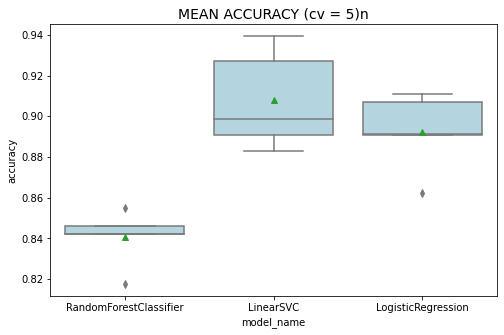

In [59]:
plt.figure(figsize=(8,5))
sns.boxplot(x='model_name', y='accuracy', 
            data=cv_df, 
            color='lightblue', 
            showmeans=True)
plt.title("MEAN ACCURACY (cv = 5)n", size=14);

## LinearSVC only

In [11]:
from sklearn.base import BaseEstimator, TransformerMixin

# Word2Vec transformer
class Word2VecTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, size=100):
        self.size = size
        self.word2vec_model = None

    def fit(self, X, y=None):
        self.word2vec_model = Word2Vec(X, size=self.size)
        return self

    def transform(self, X):
        transformed_X = []
        for sentence in X:
            sentence_vector = []
            for word in sentence.split():
                if word in self.word2vec_model.wv.vocab:
                    sentence_vector.append(self.word2vec_model.wv[word])
            transformed_X.append(sentence_vector)
        return transformed_X

In [12]:
# Split the data into features and target
X = df['text']
y = pd.get_dummies(df['label'])  # One-hot encode the labels
# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


AUC-ROC score for label 0 : 0.9380036531642849
AUC-ROC score for label 1 : 0.953306497987349
AUC-ROC score for label 2 : 0.9886968872055863
AUC-ROC score for label 3 : 0.9872139250026861


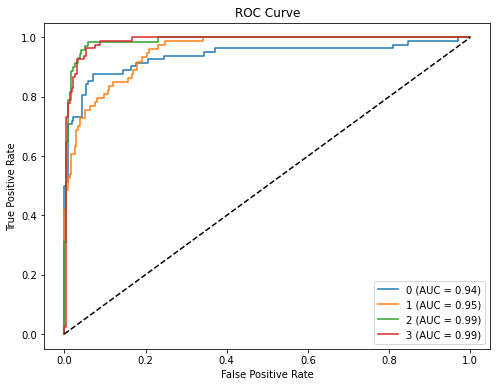

In [62]:
from sklearn.metrics import roc_curve, roc_auc_score, auc
import matplotlib.pyplot as plt


# Tokenize the sentences into words
tokenized_sentences = [text.split() for text in X_train]

# Train the Word2Vec model
word2vec_model = Word2Vec(tokenized_sentences, vector_size=15, window=60, min_count=1)

# Function to transform sentences into word vectors
def sentence_to_vectors(sentence):
    vectors = [word2vec_model.wv[word] for word in sentence.split() if word in word2vec_model.wv]
    return sum(vectors) / len(vectors) if vectors else []

# Transform the sentences into word vectors
X_train_encoded = [sentence_to_vectors(sentence) for sentence in X_train]
X_test_encoded = [sentence_to_vectors(sentence) for sentence in X_test]

# Train separate binary classifiers for each label
classifiers = {}
roc_curves = {}
auc_scores = {}


# Train separate binary classifiers for each label
classifiers = {}
auc_roc_scores = {}
for label in y.columns:
    classifier = LinearSVC()
    y_train_label = y_train[label]
    classifier.fit(X_train_encoded, y_train_label)
    classifiers[label] = classifier
    # Make predictions
    y_pred_prob_label = classifier.decision_function(X_test_encoded)
    
    # Calculate the false positive rate (FPR), true positive rate (TPR), and AUC-ROC score
    fpr, tpr, _ = roc_curve(y_test[label], y_pred_prob_label)
    roc_curves[label] = (fpr, tpr)
    auc_score = auc(fpr, tpr)
    auc_scores[label] = auc_score
    
    # Calculate the AUC-ROC score
    auc_roc = roc_auc_score(y_test[label], y_pred_prob_label)
    auc_roc_scores[label] = auc_roc

# Print the AUC-ROC scores for each label
for label, auc_roc in auc_roc_scores.items():
    print("AUC-ROC score for label", label, ":", auc_roc)
    
# Plot ROC curves
plt.figure(figsize=(8, 6))
for label, curve in roc_curves.items():
    fpr, tpr = curve
    plt.plot(fpr, tpr, label=f"{label} (AUC = {auc_scores[label]:.2f})")
    
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line for random classifier
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

## Other ways to play with weights

In [15]:
# Split the data into features and target
X = df['text']
y = df['label']
# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [16]:
# Tokenize the sentences into words
tokenized_sentences = [text.split() for text in X_train]

# Train the Word2Vec model
word2vec_model = Word2Vec(tokenized_sentences, vector_size=15, window=60, min_count=1)

# Function to transform sentences into word vectors
def sentence_to_vectors(sentence):
    vectors = [word2vec_model.wv[word] for word in sentence.split() if word in word2vec_model.wv]
    return sum(vectors) / len(vectors) if vectors else []

# Transform the sentences into word vectors
X_train_encoded = [sentence_to_vectors(sentence) for sentence in X_train]
X_test_encoded = [sentence_to_vectors(sentence) for sentence in X_test]

# Initialize the classifier
classifier = LinearSVC()

# Train the classifier
classifier.fit(X_train_encoded, y_train)


/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


LinearSVC()

In [17]:
# Make predictions on the test set
y_pred = classifier.predict(X_test_encoded)

# Print classification report
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.87      0.84      0.86        82
           1       0.88      0.72      0.79        74
           2       0.86      0.97      0.91        71
           3       0.87      0.95      0.91        82

    accuracy                           0.87       309
   macro avg       0.87      0.87      0.87       309
weighted avg       0.87      0.87      0.87       309



In [20]:
cm = confusion_matrix(y_test, y_pred)
# Calculate specificity for each class
specificity = []
for i in range(len(cm)):
    tn = sum(cm[j][j] for j in range(len(cm)) if j != i)
    fp = sum(cm[j][i] for j in range(len(cm)) if j != i)
    specificity.append(tn / (tn + fp))

print("Specificity for each class:", np.asarray(specificity).mean())


Specificity for each class: 0.9524362039843481


In [26]:
# Perform cross-validation
cv_scores = cross_val_score(classifier, X_train_encoded, y_train, cv=5)

# Print cross-validation scores
print("Cross-validation scores:", cv_scores)
print("Mean cross-validation score:", cv_scores.mean())


/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


Cross-validation scores: [0.88306452 0.91902834 0.89473684 0.92307692 0.89068826]
Mean cross-validation score: 0.9021189761003005


/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/home/biline/.local/lib/python3.8/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [22]:
import joblib
# Save the Word2Vec model
word2vec_model.save("word2vec_model.bin")

# Save the trained classifier
joblib.dump(classifier, "classifier.pkl")

['classifier.pkl']

In [28]:
# Load the Word2Vec model
word2vec_model = Word2Vec.load("word2vec_model.bin")

# Load the trained classifier
classifier = joblib.load("classifier.pkl")

In [29]:
from PIL import Image

def preprocess(instance):

    # get the image
    
    image = Image.open(instance['image_path'])
    
    
    delete_words = ['1','0.00', '|', ':', 'Tax', "'", 'e', 'la', '*', 'kkk', 'Date', 'P', 'F',"Total", 
                  "Date", "=", "&", 'Amount', 'RM']
    
    width, height = image.size
    # apply ocr to the image 
    start_time = time.time()
    text = pytesseract.image_to_string(image, config='--psm 6 -l eng')
    end_time = time.time()
    # get the words
    words = text.split()
    stopwords = nltk.corpus.stopwords.words('english')+ nltk.corpus.stopwords.words('french') + delete_words
    # Filter out the stop words
    filtered_words = list(filter(lambda word: word not in stopwords, words))
    text = ' '.join(filtered_words)
    
    return {"text": text}

# Function to transform a sentence into word vectors
def sentence_to_vectors(sentence, word2vec_model):
    vectors = [word2vec_model.wv[word] for word in sentence.split() if word in word2vec_model.wv]
    return sum(vectors) / len(vectors) if vectors else []

In [30]:
from datasets import Dataset
import time

images_path = 'test_images_text/'
# get list of image from images_path 
images = os.listdir(images_path)


print('______________________________________________________')
for image in images:
    print(image)
    start_text = time.time()
    df = pd.DataFrame({'image_path': [images_path +'/' + image]})
    test_dataset = Dataset.from_pandas(df)
    instance = test_dataset.map(preprocess)
    # Encode the new instance into word vectors
    new_instance_encoded = sentence_to_vectors(instance['text'][0], word2vec_model)

    # Reshape the new instance encoded vector
    new_instance_encoded = new_instance_encoded.reshape(1, -1)

    # Predict the label of the new instance
    predicted_label = classifier.predict(new_instance_encoded)
    end_text = time.time()
    predictions = classifier._predict_proba_lr(new_instance_encoded)[0]
    table = {}
    labels = ['id', 'invoice', 'receipt', 'resume']
    classes = ['resume', 'receipt', 'id', 'invoice']
    for i in range(len(classes)):
        table[classes[i]] = str(int(predictions[i] * 100)) + "%"
    print(table)
    # Print the predicted label
    print("Predicted label:", predicted_label, " time execution", end_text-start_text)
    print('______________________________________________________\n')



______________________________________________________
receipt3.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '10%', 'receipt': '7%', 'id': '11%', 'invoice': '71%'}
Predicted label: [3]  time execution 0.5391139984130859
______________________________________________________

receipt5.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '13%', 'receipt': '51%', 'id': '8%', 'invoice': '26%'}
Predicted label: [1]  time execution 0.42148852348327637
______________________________________________________

id3.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '34%', 'receipt': '25%', 'id': '20%', 'invoice': '19%'}
Predicted label: [0]  time execution 0.3862423896789551
______________________________________________________

receipt7.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '25%', 'receipt': '40%', 'id': '9%', 'invoice': '24%'}
Predicted label: [1]  time execution 0.5182070732116699
______________________________________________________

receipt4.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '31%', 'receipt': '27%', 'id': '26%', 'invoice': '14%'}
Predicted label: [0]  time execution 0.5053973197937012
______________________________________________________

receipt6.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '9%', 'receipt': '34%', 'id': '7%', 'invoice': '49%'}
Predicted label: [3]  time execution 0.5406608581542969
______________________________________________________

resume1.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '26%', 'receipt': '22%', 'id': '17%', 'invoice': '33%'}
Predicted label: [3]  time execution 2.018543243408203
______________________________________________________

id5.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '44%', 'receipt': '22%', 'id': '19%', 'invoice': '13%'}
Predicted label: [0]  time execution 0.6698980331420898
______________________________________________________

id1.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '33%', 'receipt': '25%', 'id': '21%', 'invoice': '19%'}
Predicted label: [0]  time execution 0.5150461196899414
______________________________________________________

invoice3.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '15%', 'receipt': '49%', 'id': '29%', 'invoice': '5%'}
Predicted label: [1]  time execution 0.5798068046569824
______________________________________________________

resume3.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '22%', 'receipt': '21%', 'id': '14%', 'invoice': '41%'}
Predicted label: [3]  time execution 1.4012932777404785
______________________________________________________

resume2.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '7%', 'receipt': '10%', 'id': '8%', 'invoice': '73%'}
Predicted label: [3]  time execution 1.3350536823272705
______________________________________________________

id2.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '43%', 'receipt': '26%', 'id': '15%', 'invoice': '15%'}
Predicted label: [0]  time execution 0.6886048316955566
______________________________________________________

invoice2.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '25%', 'receipt': '37%', 'id': '22%', 'invoice': '14%'}
Predicted label: [1]  time execution 0.6531035900115967
______________________________________________________

id4.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '38%', 'receipt': '24%', 'id': '17%', 'invoice': '20%'}
Predicted label: [0]  time execution 0.9209475517272949
______________________________________________________

invoice4.jpg


  0%|          | 0/1 [00:00<?, ?ex/s]

{'resume': '24%', 'receipt': '40%', 'id': '24%', 'invoice': '11%'}
Predicted label: [1]  time execution 0.4435553550720215
______________________________________________________

